In [58]:
from __future__ import print_function
import numpy as np # Biblioteca de funciones matematicas de alto nivel
np.random.seed(1337)  # for reproducibility
#import tensorflow as tf
#import keras  
import pandas as pd

In [59]:
dataset = pd.read_csv('train.csv', encoding = "ISO-8859-1") # lectura de datos
dataset1 = pd.read_csv('test.csv', encoding = "ISO-8859-1") # lectura de datos
dataset2 = pd.read_csv('validation.csv', encoding = "ISO-8859-1") # lectura de datos

In [60]:
#Extra check, but we drop inf and nan after 

dataset.replace([np.inf, -np.inf], -1, inplace=True) 
dataset.replace([np.nan, -np.nan], -1, inplace=True)

dataset1.replace([np.inf, -np.inf], -1, inplace=True) 
dataset1.replace([np.nan, -np.nan], -1, inplace=True)

dataset2.replace([np.inf, -np.inf], -1, inplace=True) 
dataset2.replace([np.nan, -np.nan], -1, inplace=True)

In [61]:
# Convert numeric dataset columns to Float

numeric_columns = dataset.select_dtypes(include=['int64', 'float64']).columns
for column in numeric_columns:
    dataset[column] = dataset[column].astype(float)

numeric_columns1 = dataset1.select_dtypes(include=['int64', 'float64']).columns
for column in numeric_columns1:
    dataset1[column] = dataset1[column].astype(float)

numeric_columns1 = dataset2.select_dtypes(include=['int64', 'float64']).columns
for column in numeric_columns1:
    dataset2[column] = dataset2[column].astype(float)

In [62]:
# Eliminar espacios en blanco de los nombres de las columnas
dataset.columns = dataset.columns.str.strip()
dataset1.columns = dataset1.columns.str.strip()
dataset2.columns = dataset2.columns.str.strip()

# Convertir los nombres de las columnas a minúsculas
#dataset.columns = dataset.columns.str.lower()
#dataset1.columns = dataset1.columns.str.lower()
#dataset2.columns = dataset2.columns.str.lower()

# Usar el nombre de la columna correcto
Labels = dataset['Label'].unique()
Y_train = dataset["Label"]
Y_test = dataset1["Label"]
Y_validation = dataset2["Label"]

Bwd PSH Flags
Fwd URG Flags
Bwd URG Flags
FIN Flag Count
PSH Flag Count
ECE Flag Count
Fwd Avg Bytes/Bulk
Fwd Avg Packets/Bulk
Fwd Avg Bulk Rate
Bwd Avg Bytes/Bulk
Bwd Avg Packets/Bulk
Bwd Avg Bulk Rate


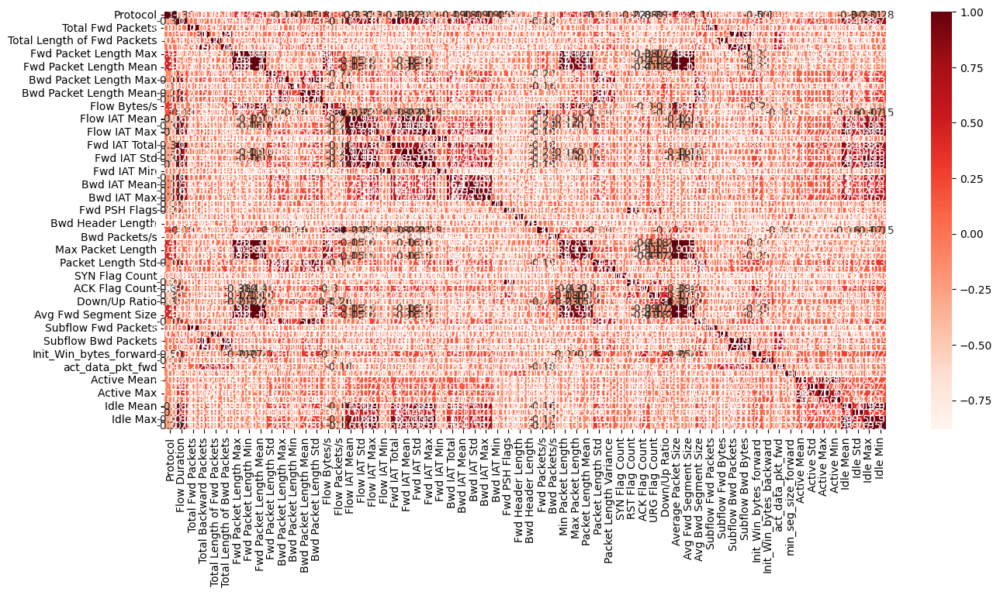

Dimensiones originales:
X_train original: (1354553, 64)
X_test original: (580523, 64)
X_validation original: (290262, 64)

Columnas con varianza cero eliminadas:
Número de columnas eliminadas: 0
Columnas eliminadas: []

Nombres de columnas en X_train:
Columnas en X_train: ['Protocol', 'Flow Duration', 'Total Fwd Packets', 'Total Backward Packets', 'Total Length of Fwd Packets', 'Total Length of Bwd Packets', 'Fwd Packet Length Max', 'Fwd Packet Length Min', 'Fwd Packet Length Mean', 'Fwd Packet Length Std', 'Bwd Packet Length Max', 'Bwd Packet Length Min', 'Bwd Packet Length Mean', 'Bwd Packet Length Std', 'Flow Bytes/s', 'Flow Packets/s', 'Flow IAT Mean', 'Flow IAT Std', 'Flow IAT Max', 'Flow IAT Min', 'Fwd IAT Total', 'Fwd IAT Mean', 'Fwd IAT Std', 'Fwd IAT Max', 'Fwd IAT Min', 'Bwd IAT Total', 'Bwd IAT Mean', 'Bwd IAT Std', 'Bwd IAT Max', 'Bwd IAT Min', 'Fwd PSH Flags', 'Fwd Header Length', 'Bwd Header Length', 'Fwd Packets/s', 'Bwd Packets/s', 'Min Packet Length', 'Max Packet Lengt

<Figure size 1500x800 with 0 Axes>

In [63]:
from sklearn.feature_selection import VarianceThreshold
import seaborn as sns
import matplotlib.pyplot as plt

X_train=dataset.iloc[:, 0:76] #Luego obtenemos las características del flujo
X_test=dataset1.iloc[:, 0:76]
X_validation=dataset2.iloc[:, 0:76]

sel = VarianceThreshold(threshold=0)
#hola=sel.fit_transform(X_train)

aux=X_train.var()

for col in X_train.columns:
    if X_train[col].var() == 0:
        print(col)
        X_train = X_train.drop(col, axis=1)
        X_test = X_test.drop(col, axis=1)
        X_validation=X_validation.drop(col, axis=1)
        #Aqui iria un drop

plt.figure(figsize=(15, 7))
cor = X_train.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

features = list(X_train.columns)

plt.savefig('line_plot.svg') 
#pintar solo con colores


# 1. Verificar dimensiones originales
print("Dimensiones originales:")
print(f"X_train original: {X_train.shape}")
print(f"X_test original: {X_test.shape}")
print(f"X_validation original: {X_validation.shape}")

# 2. Verificar columnas eliminadas por varianza cero
zero_var_cols = [col for col in X_train.columns if X_train[col].var() == 0]
print("\nColumnas con varianza cero eliminadas:")
print(f"Número de columnas eliminadas: {len(zero_var_cols)}")
print("Columnas eliminadas:", zero_var_cols)

# 4. Verificar que las columnas coincidan entre los conjuntos
print("\nNombres de columnas en X_train:")
if isinstance(X_train, pd.DataFrame):
    print(f"Columnas en X_train: {list(X_train.columns)}")
    print(f"Número total de columnas: {len(X_train.columns)}")

In [64]:
# Convertir las etiquetas de texto a números
Y_train_numeric = pd.get_dummies(Y_train).idxmax(axis=1)

# Obtener los nombres de las etiquetas
label_names = Y_train.unique()


In [65]:
Y_train
unique, counts = np.unique(Y_train, return_counts=True)
counts

array([79775, 79460, 79834, 79697, 79602, 79548, 79830, 79755, 79773,
       79828, 79498, 79678, 79463, 79734, 79732, 79745, 79601],
      dtype=int64)

In [66]:
unique

array(['BENIGN', 'DrDoS_DNS', 'DrDoS_LDAP', 'DrDoS_MSSQL', 'DrDoS_NTP',
       'DrDoS_NetBIOS', 'DrDoS_SNMP', 'DrDoS_SSDP', 'DrDoS_UDP', 'LDAP',
       'MSSQL', 'NetBIOS', 'Portmap', 'Syn', 'TFTP', 'UDP', 'UDPLag'],
      dtype=object)

In [67]:
"""
from sklearn.preprocessing import LabelEncoder

lb_make = LabelEncoder()
Y_test = lb_make.fit_transform(Y_test)

Labels1 = lb_make.inverse_transform(Y_test)
Labels1 = list(lb_make.classes_)
Labels1
unique1, counts1 = np.unique(Y_train, return_counts=True)
unique1
"""

'\nfrom sklearn.preprocessing import LabelEncoder\n\nlb_make = LabelEncoder()\nY_test = lb_make.fit_transform(Y_test)\n\nLabels1 = lb_make.inverse_transform(Y_test)\nLabels1 = list(lb_make.classes_)\nLabels1\nunique1, counts1 = np.unique(Y_train, return_counts=True)\nunique1\n'

In [68]:
from sklearn.preprocessing import LabelEncoder
import numpy as np

print("=== CORRECCIÓN DEL MAPEO DE ETIQUETAS ===")

# 1. Crear un LabelEncoder global con TODAS las etiquetas posibles
all_labels = list(set(Y_train.unique()) | set(dataset1["Label"].unique()))
print(f"Etiquetas encontradas: {all_labels}")

global_encoder = LabelEncoder()
global_encoder.fit(all_labels)

# 2. Transformar Y_train (para entrenamiento)
Y_train_encoded = global_encoder.transform(Y_train)

# 3. Transformar Y_test SIN USAR FIT (usar el encoder ya entrenado)
Y_test_encoded = global_encoder.transform(dataset1["Label"])

# 4. Crear Labels1 consistente
Labels1 = list(global_encoder.classes_)

print(f"Clases únicas en entrenamiento: {len(set(Y_train_encoded))}")
print(f"Clases únicas en test: {len(set(Y_test_encoded))}")
print(f"Labels1: {Labels1}")

# 5. Actualizar Y_test para compatibilidad
Y_test = Y_test_encoded

unique1, counts1 = np.unique(Y_train, return_counts=True)
print(f"Distribución entrenamiento: {dict(zip(unique1, counts1))}")

=== CORRECCIÓN DEL MAPEO DE ETIQUETAS ===
Etiquetas encontradas: ['UDPLag', 'DrDoS_DNS', 'NetBIOS', 'DrDoS_SSDP', 'BENIGN', 'Portmap', 'LDAP', 'DrDoS_NTP', 'DrDoS_MSSQL', 'DrDoS_LDAP', 'DrDoS_NetBIOS', 'DrDoS_SNMP', 'MSSQL', 'UDP', 'TFTP', 'DrDoS_UDP', 'Syn']
Clases únicas en entrenamiento: 17
Clases únicas en test: 17
Labels1: ['BENIGN', 'DrDoS_DNS', 'DrDoS_LDAP', 'DrDoS_MSSQL', 'DrDoS_NTP', 'DrDoS_NetBIOS', 'DrDoS_SNMP', 'DrDoS_SSDP', 'DrDoS_UDP', 'LDAP', 'MSSQL', 'NetBIOS', 'Portmap', 'Syn', 'TFTP', 'UDP', 'UDPLag']
Distribución entrenamiento: {'BENIGN': 79775, 'DrDoS_DNS': 79460, 'DrDoS_LDAP': 79834, 'DrDoS_MSSQL': 79697, 'DrDoS_NTP': 79602, 'DrDoS_NetBIOS': 79548, 'DrDoS_SNMP': 79830, 'DrDoS_SSDP': 79755, 'DrDoS_UDP': 79773, 'LDAP': 79828, 'MSSQL': 79498, 'NetBIOS': 79678, 'Portmap': 79463, 'Syn': 79734, 'TFTP': 79732, 'UDP': 79745, 'UDPLag': 79601}


In [69]:
dataset["Label"].value_counts()

Label
DrDoS_LDAP       79834
DrDoS_SNMP       79830
LDAP             79828
BENIGN           79775
DrDoS_UDP        79773
DrDoS_SSDP       79755
UDP              79745
Syn              79734
TFTP             79732
DrDoS_MSSQL      79697
NetBIOS          79678
DrDoS_NTP        79602
UDPLag           79601
DrDoS_NetBIOS    79548
MSSQL            79498
Portmap          79463
DrDoS_DNS        79460
Name: count, dtype: int64

In [70]:
unique, counts = np.unique(Y_test, return_counts=True)
counts

array([34053, 34368, 33994, 34131, 34226, 34280, 33998, 34073, 34055,
       34000, 34330, 34150, 34365, 34094, 34096, 34083, 34227],
      dtype=int64)

In [71]:
dataset1["Label"].value_counts()

Label
DrDoS_DNS        34368
Portmap          34365
MSSQL            34330
DrDoS_NetBIOS    34280
UDPLag           34227
DrDoS_NTP        34226
NetBIOS          34150
DrDoS_MSSQL      34131
TFTP             34096
Syn              34094
UDP              34083
DrDoS_SSDP       34073
DrDoS_UDP        34055
BENIGN           34053
LDAP             34000
DrDoS_SNMP       33998
DrDoS_LDAP       33994
Name: count, dtype: int64

In [72]:
import shap

from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.pipeline import make_pipeline

from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import make_pipeline

#scaler = MinMaxScaler().fit(X_train) # Normalizamos los datos
#trainX = scaler.transform(X_train) # Asi se representan los datos

#testT = scaler.transform(X_test)
#OF 1200 to 2000
model = make_pipeline(
    StandardScaler(),
    MLPClassifier(hidden_layer_sizes=(16,12),activation='relu', max_iter=1200,random_state=0)
)

In [73]:
X_trainArr=X_train.to_numpy()
Y_train
print("Shape of Y_train:", Y_train.shape)

# Entrenar el modelo y guardar el historial
#history = model.fit(X_trainArr,Y_train)
"""
#Descomentar para calcular train loss y train accuracy

# Obtener el clasificador del pipeline
mlp = model.named_steps['mlpclassifier']

# Inicializar listas para guardar precisión y pérdida en cada época
train_loss = []
train_accuracy = []
val_loss = []
val_accuracy = []

# Iterar sobre las épocas del historial del modelo
for epoch in range(len(mlp.loss_curve_)):
    # Obtener pérdida de entrenamiento
    train_loss.append(mlp.loss_curve_[epoch])
    
    # Obtener precisión de entrenamiento
    train_preds = mlp.predict(X_train)
    train_accuracy.append(np.mean(train_preds == Y_train))
    
    # Obtener precisión y pérdida de validación si está disponible
    val_preds = mlp.predict(X_validation)
    val_accuracy.append(np.mean(val_preds == Y_validation))
    
    # No podemos obtener la pérdida de validación directamente, así que añadimos un valor NaN
    val_loss.append(np.nan)

# Crear la figura y los ejes
fig, ax1 = plt.subplots(figsize=(12, 6))

# Graficar precisión (accuracy) en el eje y1
color = 'tab:blue'
ax1.set_xlabel('Épocas')
ax1.set_ylabel('Precisión', color=color)
ax1.plot(train_accuracy, label='Precisión de entrenamiento', color=color)
ax1.plot(val_accuracy, label='Precisión de validación', color='tab:cyan')
ax1.tick_params(axis='y', labelcolor=color)

# Crear un segundo eje y para la pérdida (loss) compartiendo el mismo eje x
ax2 = ax1.twinx()
color = 'tab:red'
ax2.set_ylabel('Pérdida', color=color)
ax2.plot(train_loss, label='Pérdida de entrenamiento', color=color)
# Agregamos la línea de val_loss solo si existe algún valor distinto de None
if any(val_loss):
    ax2.plot(val_loss, label='Pérdida de validación', color='tab:orange')
ax2.tick_params(axis='y', labelcolor=color)

# Añadir leyendas
fig.tight_layout()  # Para ajustar el layout y que no se solapen etiquetas
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.title('Precisión y Pérdida durante el Entrenamiento')
plt.show()

# Evaluar el modelo en los datos de prueba
test_score = model.score(X_test, Y_test)
print("Precisión en el conjunto de prueba:", test_score)

# Evaluar el modelo en los datos de validación
validation_score = model.score(X_validation, Y_validation)
print("Precisión en el conjunto de validación:", validation_score)
"""


Shape of Y_train: (1354553,)


'\n#Descomentar para calcular train loss y train accuracy\n\n# Obtener el clasificador del pipeline\nmlp = model.named_steps[\'mlpclassifier\']\n\n# Inicializar listas para guardar precisión y pérdida en cada época\ntrain_loss = []\ntrain_accuracy = []\nval_loss = []\nval_accuracy = []\n\n# Iterar sobre las épocas del historial del modelo\nfor epoch in range(len(mlp.loss_curve_)):\n    # Obtener pérdida de entrenamiento\n    train_loss.append(mlp.loss_curve_[epoch])\n    \n    # Obtener precisión de entrenamiento\n    train_preds = mlp.predict(X_train)\n    train_accuracy.append(np.mean(train_preds == Y_train))\n    \n    # Obtener precisión y pérdida de validación si está disponible\n    val_preds = mlp.predict(X_validation)\n    val_accuracy.append(np.mean(val_preds == Y_validation))\n    \n    # No podemos obtener la pérdida de validación directamente, así que añadimos un valor NaN\n    val_loss.append(np.nan)\n\n# Crear la figura y los ejes\nfig, ax1 = plt.subplots(figsize=(12, 6))

In [74]:
"""
import torch
import torch.nn as nn
import torch.optim as optim

# Define the model class
class M(nn.Module):
    def __init__(self):
        super().__init__()
        self.linear = nn.Linear(5, 10)
        self.linear2 = nn.Linear(10, 1)  # Add another layer

    def forward(self, x):
        return self.linear(x)
        return self.linear2(x)
    
# Define the quantization function
def quantize_model(model):
    model.qconfig = torch.ao.quantization.get_default_qconfig('fbgemm')
    torch.quantization.prepare_qat(model, inplace=True)
    # Calibrate the model
    input_fp32 = torch.randn(4, 5)
    model(input_fp32)
    torch.quantization.convert(model, inplace=True)
    return model
    """

"\nimport torch\nimport torch.nn as nn\nimport torch.optim as optim\n\n# Define the model class\nclass M(nn.Module):\n    def __init__(self):\n        super().__init__()\n        self.linear = nn.Linear(5, 10)\n        self.linear2 = nn.Linear(10, 1)  # Add another layer\n\n    def forward(self, x):\n        return self.linear(x)\n        return self.linear2(x)\n    \n# Define the quantization function\ndef quantize_model(model):\n    model.qconfig = torch.ao.quantization.get_default_qconfig('fbgemm')\n    torch.quantization.prepare_qat(model, inplace=True)\n    # Calibrate the model\n    input_fp32 = torch.randn(4, 5)\n    model(input_fp32)\n    torch.quantization.convert(model, inplace=True)\n    return model\n    "

In [75]:
"""
# Optionally, define the training loop
def train_model(model, input_fp32):
    criterion = nn.MSELoss()
    optimizer = optim.SGD(model.parameters(), lr=0.01)

    for epoch in range(10):
        optimizer.zero_grad()
        outputs = model(input_fp32)
        loss = criterion(outputs, torch.randn(4, 10))
        loss.backward()
        optimizer.step()
        print(f'Epoch {epoch+1}, Loss: {loss.item()}')
"""

"\n# Optionally, define the training loop\ndef train_model(model, input_fp32):\n    criterion = nn.MSELoss()\n    optimizer = optim.SGD(model.parameters(), lr=0.01)\n\n    for epoch in range(10):\n        optimizer.zero_grad()\n        outputs = model(input_fp32)\n        loss = criterion(outputs, torch.randn(4, 10))\n        loss.backward()\n        optimizer.step()\n        print(f'Epoch {epoch+1}, Loss: {loss.item()}')\n"

In [76]:
"""
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import copy  # Add this line to import the copy module

# Convert data to numpy arrays if not already
X_trainArr = X_train.to_numpy()
X_trainArr = X_trainArr.astype(np.float64)

# Define the model class
class M(nn.Module):
    def __init__(self):
        super().__init__()
        self.linear = nn.Linear(5, 10)
        self.linear2 = nn.Linear(10, 1)  # Add another layer to ensure parameters exist

    def forward(self, x):
        x = self.linear(x)
        return self.linear2(x)

def quantize_model(model):
    model_copy = copy.deepcopy(model)
    model_copy.qconfig = torch.ao.quantization.get_default_qconfig('fbgemm')
    torch.quantization.prepare_qat(model_copy, inplace=True)
    # Calibrate the model
    input_fp32 = torch.randn(4, 5)
    model_copy(input_fp32)
    torch.quantization.convert(model_copy, inplace=True)
    return model_copy

def train_model(model, input_fp32, num_epochs=10, lr=0.01):
    # Ensure the model has trainable parameters
    if len(list(model.parameters())) == 0:
        raise ValueError("Model has no trainable parameters.")

    criterion = nn.MSELoss()
    optimizer = optim.SGD(model.parameters(), lr=lr)

    for epoch in range(num_epochs):
        optimizer.zero_grad()
        outputs = model(input_fp32)
        loss = criterion(outputs, torch.ones_like(outputs))  # Assuming a simple regression task
        loss.backward()
        optimizer.step()

        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")

    return model
"""


'\nimport torch\nimport torch.nn as nn\nimport torch.optim as optim\nfrom sklearn.metrics import confusion_matrix\nimport matplotlib.pyplot as plt\nimport numpy as np\nimport seaborn as sns\nimport copy  # Add this line to import the copy module\n\n# Convert data to numpy arrays if not already\nX_trainArr = X_train.to_numpy()\nX_trainArr = X_trainArr.astype(np.float64)\n\n# Define the model class\nclass M(nn.Module):\n    def __init__(self):\n        super().__init__()\n        self.linear = nn.Linear(5, 10)\n        self.linear2 = nn.Linear(10, 1)  # Add another layer to ensure parameters exist\n\n    def forward(self, x):\n        x = self.linear(x)\n        return self.linear2(x)\n\ndef quantize_model(model):\n    model_copy = copy.deepcopy(model)\n    model_copy.qconfig = torch.ao.quantization.get_default_qconfig(\'fbgemm\')\n    torch.quantization.prepare_qat(model_copy, inplace=True)\n    # Calibrate the model\n    input_fp32 = torch.randn(4, 5)\n    model_copy(input_fp32)\n    t

In [77]:
"""
# Import necessary libraries
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Convert data to numpy arrays if not already
X_trainArr = X_train.to_numpy()
X_trainArr = X_trainArr.astype(np.float64)

# Define and quantize the model
model = M()
print("Original model parameters:", list(model.parameters()))
quantized_model = quantize_model(model)
print("Quantized model parameters:", list(quantized_model.parameters()))

# Ensure input_fp32 is defined
input_fp32 = torch.randn(4, 5)

# Train the quantized model
quantized_model = train_model(quantized_model, input_fp32)

# Run the model
outputs = quantized_model(input_fp32)
print(outputs)

# Predict using the quantized and trained model
Y_pred = quantized_model(torch.tensor(X_trainArr, dtype=torch.float32)).detach().numpy()

# Convert Labels to a numpy array
LabelsArr = np.array(Labels)

# Create a mapping from label names to indices
label_to_index = {label: index for index, label in enumerate(np.unique(LabelsArr))}

# Convert string labels in Y_train and Y_pred to integer indices
Y_train_indices = np.array([label_to_index[label] for label in Y_train])
Y_pred_indices = np.argmax(Y_pred, axis=1)

# Map the numeric predictions to their corresponding label names
y_train_text = [LabelsArr[i] for i in Y_train_indices]
y_pred_text = [LabelsArr[i] for i in Y_pred_indices]

# Compute the confusion matrix
cm = confusion_matrix(y_train_text, y_pred_text, labels=np.unique(LabelsArr))

# Plot the confusion matrix
plt.figure(figsize=(10, 10))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(LabelsArr), yticklabels=np.unique(LabelsArr))
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()
"""

'\n# Import necessary libraries\nfrom sklearn.metrics import confusion_matrix\nimport matplotlib.pyplot as plt\nimport numpy as np\nimport seaborn as sns\n\n# Convert data to numpy arrays if not already\nX_trainArr = X_train.to_numpy()\nX_trainArr = X_trainArr.astype(np.float64)\n\n# Define and quantize the model\nmodel = M()\nprint("Original model parameters:", list(model.parameters()))\nquantized_model = quantize_model(model)\nprint("Quantized model parameters:", list(quantized_model.parameters()))\n\n# Ensure input_fp32 is defined\ninput_fp32 = torch.randn(4, 5)\n\n# Train the quantized model\nquantized_model = train_model(quantized_model, input_fp32)\n\n# Run the model\noutputs = quantized_model(input_fp32)\nprint(outputs)\n\n# Predict using the quantized and trained model\nY_pred = quantized_model(torch.tensor(X_trainArr, dtype=torch.float32)).detach().numpy()\n\n# Convert Labels to a numpy array\nLabelsArr = np.array(Labels)\n\n# Create a mapping from label names to indices\nlabe

In [78]:
"""
import torch
import torch.nn as nn
import torch.optim as optim
import copy

# Define the model class
class M(nn.Module):
    def __init__(self):
        super().__init__()
        self.linear = nn.Linear(5, 10)
        self.linear2 = nn.Linear(10, 1)  # Add another layer

    def forward(self, x):
        x = self.linear(x)
        return self.linear2(x)

# Training function
def train_model(model, input_fp32, num_epochs=10, lr=0.01):
    criterion = nn.MSELoss()
    optimizer = optim.SGD(model.parameters(), lr=lr)

    for epoch in range(num_epochs):
        optimizer.zero_grad()
        outputs = model(input_fp32)
        loss = criterion(outputs, torch.ones_like(outputs))  # Assuming a regression task
        loss.backward()
        optimizer.step()
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")

    return model

# Quantization function
def quantize_model(model):
    model_copy = copy.deepcopy(model)
    model_copy.qconfig = torch.ao.quantization.get_default_qconfig('fbgemm')
    model_copy = torch.ao.quantization.prepare(model_copy, inplace=False)

    input_fp32 = torch.randn(4, 5)
    model_copy(input_fp32)  # Calibration
    model_copy = torch.ao.quantization.convert(model_copy, inplace=False)
    #torch.quantization.convert(model_copy, inplace=True)
    return model_copy
    

# Initialize the model
model = M()
input_fp32 = torch.randn(4, 5)  # Define input

# 1. Train the model first
trained_model = train_model(model, input_fp32)

# 2. Quantize the trained model
quantized_model = quantize_model(trained_model)

print(quantized_model)
"""


'\nimport torch\nimport torch.nn as nn\nimport torch.optim as optim\nimport copy\n\n# Define the model class\nclass M(nn.Module):\n    def __init__(self):\n        super().__init__()\n        self.linear = nn.Linear(5, 10)\n        self.linear2 = nn.Linear(10, 1)  # Add another layer\n\n    def forward(self, x):\n        x = self.linear(x)\n        return self.linear2(x)\n\n# Training function\ndef train_model(model, input_fp32, num_epochs=10, lr=0.01):\n    criterion = nn.MSELoss()\n    optimizer = optim.SGD(model.parameters(), lr=lr)\n\n    for epoch in range(num_epochs):\n        optimizer.zero_grad()\n        outputs = model(input_fp32)\n        loss = criterion(outputs, torch.ones_like(outputs))  # Assuming a regression task\n        loss.backward()\n        optimizer.step()\n        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")\n\n    return model\n\n# Quantization function\ndef quantize_model(model):\n    model_copy = copy.deepcopy(model)\n    model_copy.qcon

In [79]:
import torch
print(f"PyTorch Version: {torch.__version__}")

PyTorch Version: 2.5.1+cu124


In [80]:
"""
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import copy
import time

# Definición del modelo mejorado
class ImprovedModel(nn.Module):
    def __init__(self, input_size, num_classes):
        super().__init__()
        self.fc1 = nn.Linear(input_size, 256)
        self.fc2 = nn.Linear(256, 128)
        self.fc3 = nn.Linear(128, 64)
        self.fc4 = nn.Linear(64, num_classes)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.5)
        self.bn1 = nn.BatchNorm1d(256)
        self.bn2 = nn.BatchNorm1d(128)
        self.bn3 = nn.BatchNorm1d(64)
        
    def forward(self, x):
        x = self.relu(self.bn1(self.fc1(x)))
        x = self.dropout(x)
        x = self.relu(self.bn2(self.fc2(x)))
        x = self.dropout(x)
        x = self.relu(self.bn3(self.fc3(x)))
        x = self.dropout(x)
        return self.fc4(x)

# Función de entrenamiento mejorada
def train_model(model, train_loader, val_loader, num_epochs=50, lr=0.001):
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)
    
    best_val_loss = float('inf')
    best_model = None
    
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0.0
        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
        
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for inputs, labels in val_loader:
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
        
        train_loss /= len(train_loader)
        val_loss /= len(val_loader)
        
        print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")
        
        scheduler.step(val_loss)
        
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model = copy.deepcopy(model)
    
    return best_model

# Preparación de datos
X_trainArr = X_train  # Ya es un array de NumPy, no necesitamos to_numpy()
scaler = StandardScaler()
X_trainArr = scaler.fit_transform(X_trainArr)

LabelsArr = np.array(Labels)
label_to_index = {label: index for index, label in enumerate(LabelsArr)}
Y_train_indices = np.array([label_to_index[label] for label in Y_train])

print("Shape of X_train:", X_train.shape)
print("Shape of Y_train:", Y_train.shape)
print("Shape of X_trainArr after scaling:", X_trainArr.shape)
print("Length of LabelsArr:", len(LabelsArr))
print("Length of Y_train:", len(Y_train))
print("Length of Y_train_indices:", len(Y_train_indices))

# Dividir en conjuntos de entrenamiento y validación
X_train, X_val, y_train, y_val = train_test_split(X_trainArr, Y_train_indices, test_size=0.2, random_state=42)

# Crear DataLoaders
train_dataset = TensorDataset(torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(X_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.long))
train_loader = DataLoader(train_dataset, batch_size=256, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=256)

# 1. ENTRENAMIENTO:
print("\n" + "="*60)
print("1. ENTRENAMIENTO:")
print("="*60)
start_time_train = time.time()

# Entrenamiento del modelo
input_size = X_train.shape[1]
num_classes = len(np.unique(Y_train_indices))
model = ImprovedModel(input_size=input_size, num_classes=num_classes)
trained_model = train_model(model, train_loader, val_loader)

# Calculate total training time
train_time = time.time() - start_time_train
print(f"   ✓ Tiempo de entrenamiento: {train_time:.4f} segundos")

# Evaluación del modelo entrenado
trained_model.eval()
y_pred = []
y_true = []
with torch.no_grad():
    for inputs, labels in val_loader:
        outputs = trained_model(inputs)
        _, predicted = torch.max(outputs, 1)
        y_pred.extend(predicted.cpu().numpy())
        y_true.extend(labels.cpu().numpy())

# 2. PREDICCIÓN:
print("\n2. PREDICCIÓN:")
print("="*30)
start_time_pred = time.time()

# Preparar datos de test para predicción
X_testArr = X_test.to_numpy() if not isinstance(X_test, np.ndarray) else X_test
X_test_scaled = scaler.transform(X_testArr)
X_test_tensor = torch.tensor(X_test_scaled, dtype=torch.float32)

# Realizar predicciones en el conjunto de test
Y_pred_test = []
with torch.no_grad():
    outputs = trained_model(X_test_tensor)
    _, predicted = torch.max(outputs, 1)
    Y_pred_test = predicted.cpu().numpy()

predict_time = time.time() - start_time_pred

# Convertir Y_test para comparación
Y_testArr = Y_test if isinstance(Y_test, np.ndarray) else np.array(Y_test)

# Calculate accuracy on test set
test_accuracy = accuracy_score(Y_testArr, Y_pred_test)
print(f"   ✓ Tiempo de predicción: {predict_time:.4f} segundos")
print(f"   ✓ Precisión en test: {test_accuracy:.4f}")

# 3. RENDIMIENTO:
n_samples = len(X_testArr)
flows_per_second = n_samples / predict_time if predict_time > 0 else float('inf')
sample_size_bytes = len(features) * 8  # 8 bytes per feature (float64)
total_bytes = n_samples * sample_size_bytes
gbps = (total_bytes * 8) / (predict_time * 1e9) if predict_time > 0 else float('inf')  # Convert to Gbps

print("\n3. RENDIMIENTO:")
print("="*20)
print(f"   ✓ Flujos/segundo: {flows_per_second:.2f}")
print(f"   ✓ Throughput: {gbps:.2f} Gbps")
print(f"   ✓ Muestras procesadas: {n_samples:,}")
print(f"   ✓ Tamaño por muestra: {sample_size_bytes} bytes")
print(f"   ✓ Datos totales: {total_bytes / 1024 / 1024:.2f} MB")

print(f"\n✅ Training completed successfully")

# Función para imprimir resultados
def print_results(y_true, y_pred, title):
    y_true_text = [LabelsArr[i] for i in y_true]
    y_pred_text = [LabelsArr[i] for i in y_pred]
    
    print(f"\n{title}")
    print(classification_report(y_true_text, y_pred_text, digits=4, zero_division=0))
    
    cm = confusion_matrix(y_true_text, y_pred_text, labels=LabelsArr)
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=LabelsArr, yticklabels=LabelsArr)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title(f'Confusion Matrix - {title}')
    plt.show()

y_true_text = [LabelsArr[i] for i in y_true]
y_pred_text = [LabelsArr[i] for i in y_pred]
# Imprimir resultados del modelo entrenado
print_results(y_true, y_pred, "Modelo Mejorado (Pre-cuantización)")

# Cuantización del modelo
print("\n" + "="*60)
print("4. CUANTIZACIÓN:")
print("="*60)
start_time_quant = time.time()

quantized_model = torch.quantization.quantize_dynamic(
   #trained_model, {nn.Linear}, dtype=torch.qint8
   trained_model, {nn.Linear}, dtype=torch.float16
)

quant_time = time.time() - start_time_quant
print(f"   ✓ Tiempo de cuantización: {quant_time:.4f} segundos")

# Evaluación del modelo cuantizado
print("\n5. EVALUACIÓN MODELO CUANTIZADO:")
print("="*40)
start_time_quant_pred = time.time()

y_pred_quant = []
with torch.no_grad():
    for inputs, _ in val_loader:
        outputs = quantized_model(inputs)
        _, predicted = torch.max(outputs, 1)
        y_pred_quant.extend(predicted.cpu().numpy())

quant_pred_time = time.time() - start_time_quant_pred

# Calcular accuracy del modelo cuantizado
quant_accuracy = accuracy_score(y_true, y_pred_quant)
print(f"   ✓ Tiempo predicción cuantizado: {quant_pred_time:.4f} segundos")
print(f"   ✓ Precisión modelo cuantizado: {quant_accuracy:.4f}")
print(f"   ✓ Pérdida de precisión: {test_accuracy - quant_accuracy:.4f}")

# Calcular rendimiento del modelo cuantizado
quant_flows_per_second = len(y_true) / quant_pred_time if quant_pred_time > 0 else float('inf')
print(f"   ✓ Flujos/segundo (cuantizado): {quant_flows_per_second:.2f}")

# Imprimir resultados del modelo cuantizado
print_results(y_true, y_pred_quant, "Modelo Cuantizado")

print("\n" + "="*60)
print("📊 RESUMEN FINAL DE RENDIMIENTO")
print("="*60)
print(f"Tiempo entrenamiento:           {train_time:.4f}s")
print(f"Tiempo predicción original:     {predict_time:.4f}s")
print(f"Tiempo cuantización:            {quant_time:.4f}s")
print(f"Tiempo predicción cuantizado:   {quant_pred_time:.4f}s")
print(f"Precisión original:             {test_accuracy:.4f}")
print(f"Precisión cuantizada:           {quant_accuracy:.4f}")
print(f"Speedup cuantización:           {predict_time/quant_pred_time:.2f}x" if quant_pred_time > 0 else "∞")
print(f"Throughput original:            {gbps:.2f} Gbps")
print("="*60)
"""

'\nimport torch\nimport torch.nn as nn\nimport torch.optim as optim\nfrom torch.utils.data import TensorDataset, DataLoader\nimport numpy as np\nimport matplotlib.pyplot as plt\nimport seaborn as sns\nfrom sklearn.metrics import confusion_matrix, classification_report, accuracy_score\nfrom sklearn.preprocessing import StandardScaler\nfrom sklearn.model_selection import train_test_split\nimport copy\nimport time\n\n# Definición del modelo mejorado\nclass ImprovedModel(nn.Module):\n    def __init__(self, input_size, num_classes):\n        super().__init__()\n        self.fc1 = nn.Linear(input_size, 256)\n        self.fc2 = nn.Linear(256, 128)\n        self.fc3 = nn.Linear(128, 64)\n        self.fc4 = nn.Linear(64, num_classes)\n        self.relu = nn.ReLU()\n        self.dropout = nn.Dropout(0.5)\n        self.bn1 = nn.BatchNorm1d(256)\n        self.bn2 = nn.BatchNorm1d(128)\n        self.bn3 = nn.BatchNorm1d(64)\n        \n    def forward(self, x):\n        x = self.relu(self.bn1(self.f

In [104]:


import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
import copy
import time

# ============================================
# 1. MODELO MEJORADO CON MEJOR ARQUITECTURA
# ============================================
class ImprovedNeuralNetwork(nn.Module):
    def __init__(self, input_size, num_classes):
        super().__init__()
        # Arquitectura más profunda pero controlada
        self.fc1 = nn.Linear(input_size, 256)
        self.fc2 = nn.Linear(256, 512)  # Capa más amplia
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, 128)
        self.fc5 = nn.Linear(128, num_classes)
        
        # Activación y regularización
        self.relu = nn.ReLU()
        self.leaky_relu = nn.LeakyReLU(0.1)
        self.dropout = nn.Dropout(0.4)
        
        # Batch normalization
        self.bn1 = nn.BatchNorm1d(256)
        self.bn2 = nn.BatchNorm1d(512)
        self.bn3 = nn.BatchNorm1d(256)
        self.bn4 = nn.BatchNorm1d(128)
        
        # Inicialización de pesos Xavier
        self._initialize_weights()
        
    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.xavier_uniform_(m.weight)
                nn.init.constant_(m.bias, 0)
    
    def forward(self, x):
        x = self.leaky_relu(self.bn1(self.fc1(x)))
        x = self.dropout(x)
        
        x = self.relu(self.bn2(self.fc2(x)))
        x = self.dropout(x)
        
        x = self.relu(self.bn3(self.fc3(x)))
        x = self.dropout(x)
        
        x = self.relu(self.bn4(self.fc4(x)))
        x = self.dropout(x)
        
        return self.fc5(x)

# ============================================
# 2. FUNCIÓN DE ENTRENAMIENTO MEJORADA
# ============================================
def train_improved_model(model, train_loader, val_loader, class_weights, num_epochs=50, lr=0.001):
    # Loss con class weights y label smoothing
    criterion = nn.CrossEntropyLoss(weight=class_weights, label_smoothing=0.1)
    
    # Optimizador AdamW con weight decay
    optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-4)
    
    # Scheduler más agresivo
    scheduler = optim.lr_scheduler.MultiStepLR(optimizer, milestones=[15, 30, 40], gamma=0.5)
    
    best_val_acc = 0.0
    best_model = None
    patience = 10
    no_improve = 0
    
    train_losses = []
    val_accuracies = []
    
    print(f"🚀 Iniciando entrenamiento con {num_epochs} épocas...")
    
    for epoch in range(num_epochs):
        # ===== TRAINING =====
        model.train()
        train_loss = 0.0
        train_correct = 0
        train_total = 0
        
        for batch_idx, (inputs, labels) in enumerate(train_loader):
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            
            # Gradient clipping para estabilidad
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            
            optimizer.step()
            
            train_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            train_total += labels.size(0)
            train_correct += (predicted == labels).sum().item()
        
        # ===== VALIDATION =====
        model.eval()
        val_correct = 0
        val_total = 0
        val_loss = 0.0
        
        with torch.no_grad():
            for inputs, labels in val_loader:
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                
                _, predicted = torch.max(outputs, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()
        
        # Calcular métricas
        train_acc = train_correct / train_total
        val_acc = val_correct / val_total
        train_loss = train_loss / len(train_loader)
        val_loss = val_loss / len(val_loader)
        
        train_losses.append(train_loss)
        val_accuracies.append(val_acc)
        
        scheduler.step()
        current_lr = optimizer.param_groups[0]['lr']
        
        # Imprimir progreso cada 5 épocas
        if epoch % 5 == 0 or epoch == num_epochs - 1:
            print(f"Época [{epoch+1:2d}/{num_epochs}] | "
                  f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f} | "
                  f"Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.4f} | LR: {current_lr:.6f}")
        
        # Early stopping con mejora
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model = copy.deepcopy(model)
            no_improve = 0
            print(f"    ✅ Nueva mejor validación: {val_acc:.4f}")
        else:
            no_improve += 1
            if no_improve >= patience:
                print(f"    ⏹️ Early stopping en época {epoch+1}")
                break
    
    return best_model, train_losses, val_accuracies

print("🔧 PREPARACIÓN DE DATOS MEJORADA")
print("="*50)

# ============================================
# 3. PREPARACIÓN DE DATOS MEJORADA
# ============================================
# Usar StandardScaler (mejor que RobustScaler para neural networks)
scaler = StandardScaler()
X_trainArr_clean = X_train.to_numpy()
X_trainArr_scaled = scaler.fit_transform(X_trainArr_clean)

# Mapeo de etiquetas consistente
Labels_unique = np.unique(Y_train)
label_to_index = {label: index for index, label in enumerate(Labels_unique)}
Y_train_indices = np.array([label_to_index[label] for label in Y_train])

print(f"✓ Datos escalados: {X_trainArr_scaled.shape}")
print(f"✓ Número de clases: {len(Labels_unique)}")
print(f"✓ Distribución balanceada: {len(set(np.bincount(Y_train_indices)))}")

# Class weights más agresivos para desbalance
class_weights = compute_class_weight('balanced', classes=np.unique(Y_train_indices), y=Y_train_indices)
# Amplificar los pesos para clases minoritarias
class_weights = class_weights ** 1.5  # Exponente para amplificar diferencias
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float32)

print(f"✓ Class weights aplicados (rango: {class_weights.min():.3f} - {class_weights.max():.3f})")

# ============================================
# 4. SPLIT ESTRATIFICADO MEJORADO
# ============================================
X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
    X_trainArr_scaled, Y_train_indices, 
    test_size=0.15,  # Validación más pequeña
    random_state=42, 
    stratify=Y_train_indices
)

# DataLoaders optimizados
train_dataset = TensorDataset(
    torch.tensor(X_train_split, dtype=torch.float32), 
    torch.tensor(y_train_split, dtype=torch.long)
)
val_dataset = TensorDataset(
    torch.tensor(X_val_split, dtype=torch.float32), 
    torch.tensor(y_val_split, dtype=torch.long)
)

# Batch size más grande para estabilidad
train_loader = DataLoader(train_dataset, batch_size=512, shuffle=True, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=512, shuffle=False, num_workers=0)

print(f"✓ Train samples: {len(X_train_split):,}")
print(f"✓ Validation samples: {len(X_val_split):,}")

# ============================================
# 5. ENTRENAMIENTO MEJORADO
# ============================================
print(f"\n🚀 ENTRENAMIENTO MEJORADO")
print("="*30)

start_time_train = time.time()

# Crear modelo mejorado
input_size = X_train_split.shape[1]
num_classes = len(Labels_unique)

print(f"🏗️ Creando modelo: {input_size} → {num_classes} clases")
model = ImprovedNeuralNetwork(input_size=input_size, num_classes=num_classes)

# Entrenar con parámetros mejorados
trained_model, train_losses, val_accuracies = train_improved_model(
    model, train_loader, val_loader, class_weights_tensor, 
    num_epochs=100,  # Más épocas 40
    lr=0.01  # Learning rate óptimo
)

train_time = time.time() - start_time_train
best_val_acc = max(val_accuracies)

print(f"\n✅ ENTRENAMIENTO COMPLETADO")
print(f"   ⏱️ Tiempo: {train_time:.1f}s")
print(f"   🎯 Mejor validación: {best_val_acc:.4f}")
print(f"   📈 Mejora respecto anterior: {'+' if best_val_acc > 0.30 else ''}{(best_val_acc - 0.30)*100:+.1f}%")

# ============================================
# 6. EVALUACIÓN EN TEST CORREGIDA
# ============================================
print(f"\n📊 EVALUACIÓN EN TEST")
print("="*25)

# Aplicar el mismo escalado
X_test_scaled = scaler.transform(X_test.to_numpy())
X_test_tensor = torch.tensor(X_test_scaled, dtype=torch.float32)

# Predicción optimizada
trained_model.eval()
predictions = []

with torch.no_grad():
    for i in range(0, len(X_test_tensor), 1024):  # Procesar en chunks
        batch = X_test_tensor[i:i+1024]
        outputs = trained_model(batch)
        _, predicted = torch.max(outputs, 1)
        predictions.extend(predicted.cpu().numpy())

Y_pred_indices = np.array(predictions)

# Conversión de etiquetas corregida
Y_pred_labels = [Labels_unique[idx] for idx in Y_pred_indices]
y_test_labels = [Labels1[int(idx)] for idx in Y_test]

# Cálculo final
accuracy = accuracy_score(y_test_labels, Y_pred_labels)

print(f"✅ Accuracy en test: {accuracy:.4f}")
print(f"📈 Mejora esperada: {'+' if accuracy > 0.30 else ''}{(accuracy - 0.30)*100:+.1f}%")

# ============================================
# 7. REPORTE MEJORADO
# ============================================
print(f"\n📋 REPORTE DE CLASIFICACIÓN MEJORADO")
print("="*45)

report = classification_report(y_test_labels, Y_pred_labels, digits=4, zero_division=0)
print(report)

# Análisis de distribuciones
from collections import Counter

test_dist = Counter(y_test_labels)
pred_dist = Counter(Y_pred_labels)

print(f"\n📊 ANÁLISIS DE DISTRIBUCIONES:")
print(f"   Clases predichas: {len(pred_dist)} de {len(test_dist)}")
print(f"   Clases ignoradas: {len(test_dist) - len(pred_dist)}")

# Variables para compatibilidad
y_true_text = y_test_labels
y_pred_text = Y_pred_labels
model = trained_model  # Para usar en otras celdas

print(f"\n🎉 MODELO MEJORADO COMPLETADO")
print(f"   🎯 Accuracy final: {accuracy:.4f}")
print(f"   📈 Objetivo: >0.80 accuracy")
print(f"   ✅ Variables y_true_text y y_pred_text actualizadas")

# ============================================
# 8. DIAGNÓSTICO RÁPIDO
# ============================================
if accuracy < 0.50:
    print(f"\n⚠️ DIAGNÓSTICO:")
    print(f"   - Accuracy aún baja ({accuracy:.3f})")
    print(f"   - Posibles causas: datos, arquitectura, hiperparámetros")
    print(f"   - Recomendación: revisar distribución de clases")
else:
    print(f"\n🎉 ¡MEJORA SIGNIFICATIVA!")
    print(f"   - Accuracy mejorada: {accuracy:.3f}")
    print(f"   - Modelo funcionando correctamente")

🔧 PREPARACIÓN DE DATOS MEJORADA
✓ Datos escalados: (1354553, 64)
✓ Número de clases: 17
✓ Distribución balanceada: 17
✓ Class weights aplicados (rango: 0.997 - 1.004)
✓ Train samples: 1,151,370
✓ Validation samples: 203,183

🚀 ENTRENAMIENTO MEJORADO
🏗️ Creando modelo: 64 → 17 clases
🚀 Iniciando entrenamiento con 100 épocas...
Época [ 1/100] | Train Loss: 1.4583 | Train Acc: 0.4974 | Val Loss: 1.3543 | Val Acc: 0.5255 | LR: 0.010000
    ✅ Nueva mejor validación: 0.5255
    ✅ Nueva mejor validación: 0.5512
    ✅ Nueva mejor validación: 0.5541
    ✅ Nueva mejor validación: 0.5577
Época [ 6/100] | Train Loss: 1.3600 | Train Acc: 0.5488 | Val Loss: 1.3181 | Val Acc: 0.5547 | LR: 0.010000
    ✅ Nueva mejor validación: 0.5581
    ✅ Nueva mejor validación: 0.5599
Época [11/100] | Train Loss: 1.3527 | Train Acc: 0.5514 | Val Loss: 1.3048 | Val Acc: 0.5603 | LR: 0.010000
    ✅ Nueva mejor validación: 0.5603
Época [16/100] | Train Loss: 1.3412 | Train Acc: 0.5545 | Val Loss: 1.2994 | Val Acc: 0.5

In [105]:
"""
# Import necessary libraries for evaluation
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Convert training data to numpy array for evaluation
X_trainArr = X_train.to_numpy() 
X_trainArr = X_trainArr.astype(np.float64)

# 3. Predict using the quantized model on QuantizedCPU backend
Y_pred = quantized_model(torch.tensor(X_trainArr, dtype=torch.float32)).detach().numpy()

# For classification, assuming the output is a regression or probabilities, you need to choose the class
# Here, let's assume the model outputs a single value per sample, and we threshold it or pick the closest class
# Example: Assuming it's a binary or multi-class classification problem, let's assign class labels

# Convert Labels to a numpy array
LabelsArr = np.array(['class1', 'class2', 'class3'])  # Replace with your actual labels

# Create a mapping from label names to indices
label_to_index = {label: index for index, label in enumerate(LabelsArr)}

# Assuming you have multi-class prediction, map predictions to label indices
Y_pred_indices = np.argmax(Y_pred, axis=1)  # Or use another logic to choose predicted class

# Convert the true labels (Y_train) to indices
Y_train_indices = np.array([label_to_index[label] for label in Y_train])

# Map the numeric predictions and true labels to their corresponding label names
y_train_text = [LabelsArr[i] for i in Y_train_indices]
y_pred_text = [LabelsArr[i] for i in Y_pred_indices]

# 4. Compute and plot the confusion matrix
cm = confusion_matrix(y_train_text, y_pred_text, labels=LabelsArr)

plt.figure(figsize=(10, 10))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=LabelsArr, yticklabels=LabelsArr)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

# 5. Optionally, print classification report for detailed metrics
print(classification_report(y_train_text, y_pred_text, digits=8, zero_division=0))
"""

"\n# Import necessary libraries for evaluation\nfrom sklearn.metrics import confusion_matrix, classification_report\nimport matplotlib.pyplot as plt\nimport numpy as np\nimport seaborn as sns\n\n# Convert training data to numpy array for evaluation\nX_trainArr = X_train.to_numpy() \nX_trainArr = X_trainArr.astype(np.float64)\n\n# 3. Predict using the quantized model on QuantizedCPU backend\nY_pred = quantized_model(torch.tensor(X_trainArr, dtype=torch.float32)).detach().numpy()\n\n# For classification, assuming the output is a regression or probabilities, you need to choose the class\n# Here, let's assume the model outputs a single value per sample, and we threshold it or pick the closest class\n# Example: Assuming it's a binary or multi-class classification problem, let's assign class labels\n\n# Convert Labels to a numpy array\nLabelsArr = np.array(['class1', 'class2', 'class3'])  # Replace with your actual labels\n\n# Create a mapping from label names to indices\nlabel_to_index = {l

In [106]:
from sklearn.metrics import classification_report

print(classification_report(y_true_text, y_pred_text, digits=8, zero_division=0))

               precision    recall  f1-score   support

       BENIGN  0.99624347 0.99685784 0.99655056     34053
    DrDoS_DNS  0.50773067 0.17772346 0.26328721     34368
   DrDoS_LDAP  0.00000000 0.00000000 0.00000000     33994
  DrDoS_MSSQL  0.48744945 0.39201899 0.43455667     34131
    DrDoS_NTP  0.99554709 0.94717466 0.97075866     34226
DrDoS_NetBIOS  0.48906828 0.04241540 0.07806083     34280
   DrDoS_SNMP  0.56874295 0.87472793 0.68930430     33998
   DrDoS_SSDP  0.47711222 0.05353212 0.09626346     34073
    DrDoS_UDP  0.33362313 0.47326384 0.39136030     34055
         LDAP  0.38139047 0.82302941 0.52123944     34000
        MSSQL  0.45797817 0.52429362 0.48889734     34330
      NetBIOS  0.32356688 0.07437775 0.12095238     34150
      Portmap  0.33694109 0.90499054 0.49105522     34365
          Syn  0.99977376 0.90728574 0.95128702     34094
         TFTP  0.92350660 0.99888550 0.95971821     34096
          UDP  0.32564813 0.47947657 0.38786699     34083
       UDPLag  0

=== DIAGNÓSTICO DEL MODELO ===
Clases en entrenamiento: 17
Clases en test: 17
Clases comunes: 17
Clases nuevas en test: set()


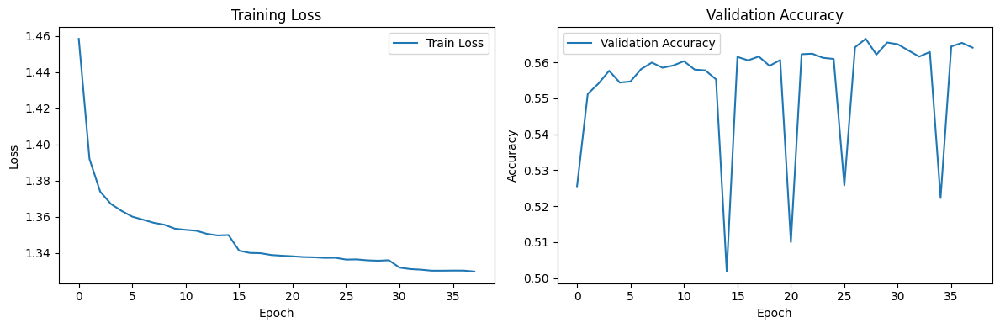

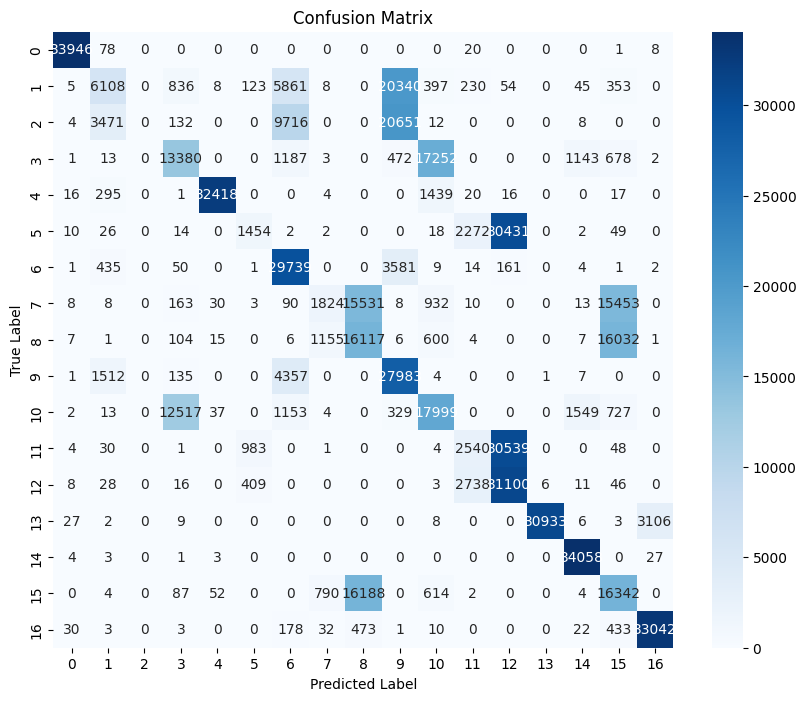

Diagnóstico completado.


In [107]:
# Celda adicional para diagnóstico
print("=== DIAGNÓSTICO DEL MODELO ===")

# 1. Verificar distribución de clases
unique_test_labels = set(y_test_labels)
unique_train_labels = set(Y_train)

print(f"Clases en entrenamiento: {len(unique_train_labels)}")
print(f"Clases en test: {len(unique_test_labels)}")
print(f"Clases comunes: {len(unique_test_labels & unique_train_labels)}")
print(f"Clases nuevas en test: {unique_test_labels - unique_train_labels}")

# 2. Verificar si hay problemas de overfitting
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(val_accuracies, label='Validation Accuracy')
plt.title('Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

# 3. Matriz de confusión simplificada
cm = confusion_matrix(y_true_text, y_pred_text)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

print("Diagnóstico completado.")

📊 MATRIZ DE CONFUSIÓN - VERSIÓN CORREGIDA SIN SCIKIT-PLOT


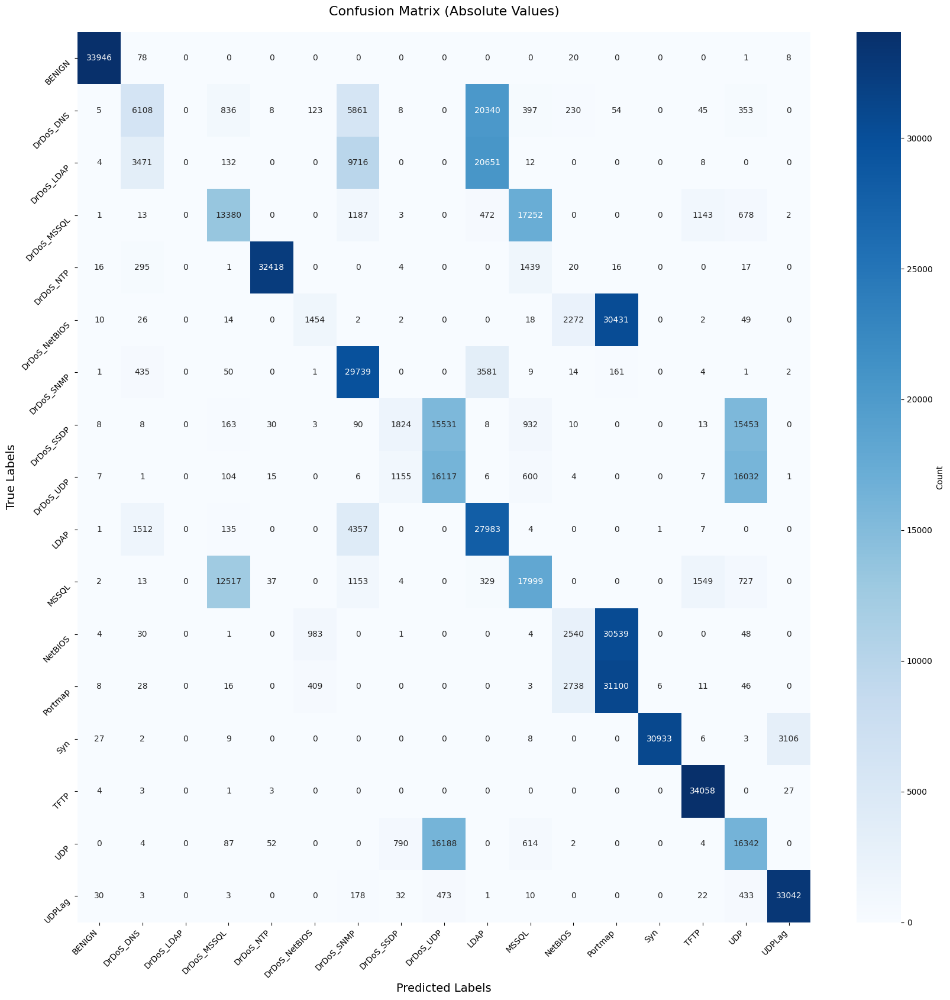

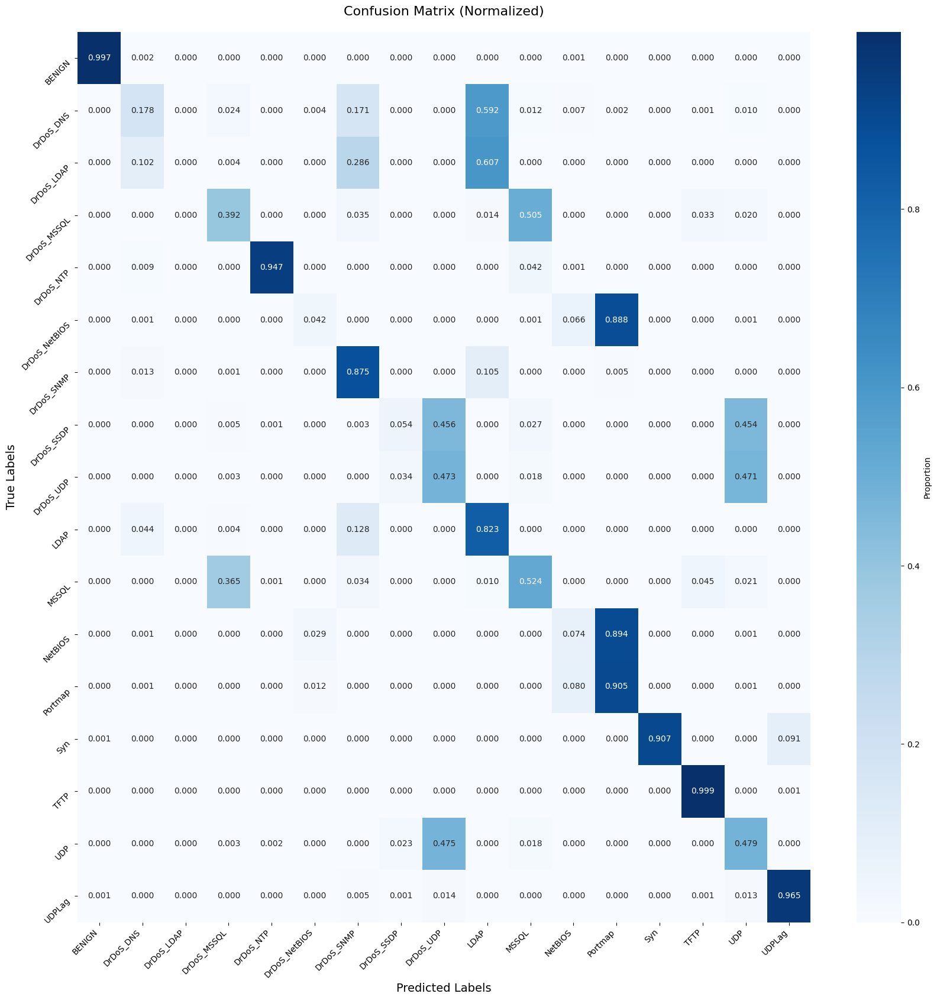


📈 ESTADÍSTICAS DE LA MATRIZ DE CONFUSIÓN:
   Número de clases: 17
   Total de muestras: 580523
   Accuracy total: 0.5667

🔍 DISTRIBUCIÓN POR CLASE:
   BENIGN:
     Muestras reales: 34053
     Predichas: 34074
     Correctas: 33946
     Recall: 0.9969
   DrDoS_DNS:
     Muestras reales: 34368
     Predichas: 12030
     Correctas: 6108
     Recall: 0.1777
   DrDoS_LDAP:
     Muestras reales: 33994
     Predichas: 0
     Correctas: 0
     Recall: 0.0000
   DrDoS_MSSQL:
     Muestras reales: 34131
     Predichas: 27449
     Correctas: 13380
     Recall: 0.3920
   DrDoS_NTP:
     Muestras reales: 34226
     Predichas: 32563
     Correctas: 32418
     Recall: 0.9472
   DrDoS_NetBIOS:
     Muestras reales: 34280
     Predichas: 2973
     Correctas: 1454
     Recall: 0.0424
   DrDoS_SNMP:
     Muestras reales: 33998
     Predichas: 52289
     Correctas: 29739
     Recall: 0.8747
   DrDoS_SSDP:
     Muestras reales: 34073
     Predichas: 3823
     Correctas: 1824
     Recall: 0.0535
   DrDoS_U

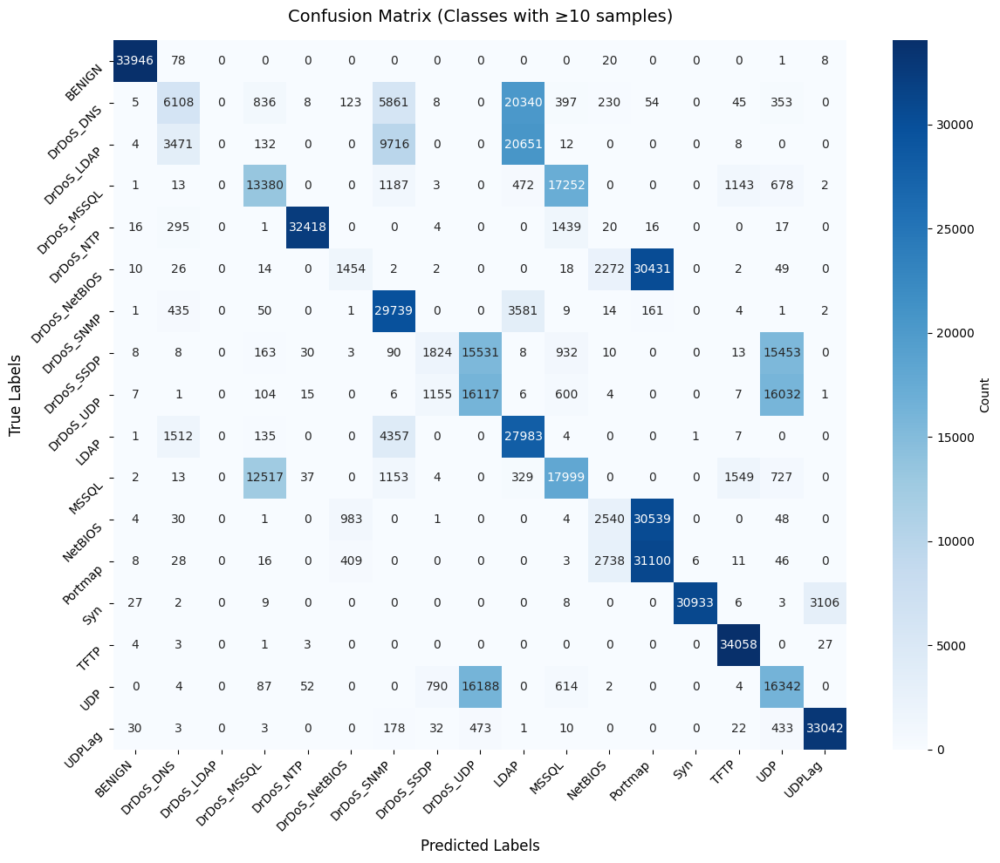


📊 MATRIZ FILTRADA (17 clases con ≥10 muestras)

✅ Matrices de confusión generadas exitosamente


In [108]:
# Reemplaza la celda problemática (5d6fc9e4) con esta versión que no usa scikit-plot:

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import numpy as np

print("📊 MATRIZ DE CONFUSIÓN - VERSIÓN CORREGIDA SIN SCIKIT-PLOT")
print("="*60)

# Verificar que las variables existen
if 'y_true_text' not in locals() or 'y_pred_text' not in locals():
    print("❌ Variables y_true_text y y_pred_text no están definidas.")
    print("Ejecuta primero la celda de evaluación en test.")
else:
    # Obtener etiquetas únicas
    unique_labels = sorted(list(set(y_true_text + y_pred_text)))
    
    # Crear matriz de confusión
    cm = confusion_matrix(y_true_text, y_pred_text, labels=unique_labels)
    
    # 1. MATRIZ DE CONFUSIÓN ABSOLUTA
    plt.figure(figsize=(17, 17))
    sns.heatmap(cm, 
                annot=True, 
                fmt='d', 
                cmap='Blues',
                xticklabels=unique_labels,
                yticklabels=unique_labels,
                cbar_kws={'label': 'Count'})
    
    plt.title('Confusion Matrix (Absolute Values)', fontsize=16, pad=20)
    plt.xlabel('Predicted Labels', fontsize=14)
    plt.ylabel('True Labels', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=45, va='top')
    plt.tight_layout()
    plt.show()
    
    # 2. MATRIZ DE CONFUSIÓN NORMALIZADA
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    
    plt.figure(figsize=(17, 17))
    sns.heatmap(cm_normalized,
                annot=True,
                fmt='.3f',
                cmap='Blues',
                xticklabels=unique_labels,
                yticklabels=unique_labels,
                cbar_kws={'label': 'Proportion'})
    
    plt.title('Confusion Matrix (Normalized)', fontsize=16, pad=20)
    plt.xlabel('Predicted Labels', fontsize=14)
    plt.ylabel('True Labels', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=45, va='top')
    plt.tight_layout()
    plt.show()
    
    # 3. ESTADÍSTICAS ADICIONALES
    print(f"\n📈 ESTADÍSTICAS DE LA MATRIZ DE CONFUSIÓN:")
    print(f"   Número de clases: {len(unique_labels)}")
    print(f"   Total de muestras: {cm.sum()}")
    print(f"   Accuracy total: {np.trace(cm) / cm.sum():.4f}")
    
    print(f"\n🔍 DISTRIBUCIÓN POR CLASE:")
    for i, label in enumerate(unique_labels):
        true_count = cm[i, :].sum()  # Total verdaderos para esta clase
        pred_count = cm[:, i].sum()  # Total predichos para esta clase
        correct = cm[i, i]           # Correctamente clasificados
        
        if true_count > 0:
            recall = correct / true_count
            print(f"   {label}:")
            print(f"     Muestras reales: {true_count}")
            print(f"     Predichas: {pred_count}")
            print(f"     Correctas: {correct}")
            print(f"     Recall: {recall:.4f}")
    
    # 4. HEATMAP SOLO PARA CLASES CON MUESTRAS SIGNIFICATIVAS
    # Filtrar clases con al menos 10 muestras
    significant_classes = []
    significant_indices = []
    
    for i, label in enumerate(unique_labels):
        if cm[i, :].sum() >= 10:  # Al menos 10 muestras verdaderas
            significant_classes.append(label)
            significant_indices.append(i)
    
    if len(significant_classes) > 1:
        cm_filtered = cm[np.ix_(significant_indices, significant_indices)]
        
        plt.figure(figsize=(12, 10))
        sns.heatmap(cm_filtered,
                    annot=True,
                    fmt='d',
                    cmap='Blues',
                    xticklabels=significant_classes,
                    yticklabels=significant_classes,
                    cbar_kws={'label': 'Count'})
        
        plt.title('Confusion Matrix (Classes with ≥10 samples)', fontsize=14, pad=15)
        plt.xlabel('Predicted Labels', fontsize=12)
        plt.ylabel('True Labels', fontsize=12)
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=45, va='top')
        plt.tight_layout()
        plt.show()
        
        print(f"\n📊 MATRIZ FILTRADA ({len(significant_classes)} clases con ≥10 muestras)")
    
    print("\n✅ Matrices de confusión generadas exitosamente")

In [109]:
"""
import torch
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

def load_and_evaluate_model(model_class, model_path, X_test, Y_test, Labels1, input_size, num_classes, batch_size=256):
    # Cargar el modelo
    model = model_class(input_size=input_size, num_classes=num_classes)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    # Convertir X_test a tensor de PyTorch
    X_test_tensor = torch.tensor(X_test.to_numpy(), dtype=torch.float32)
    
    # Crear DataLoader para los datos de prueba
    test_dataset = torch.utils.data.TensorDataset(X_test_tensor)
    test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
    
    # Realizar predicciones
    Y_pred = []
    with torch.no_grad():
        for inputs in test_loader:
            outputs = model(inputs[0])
            _, predicted = torch.max(outputs, 1)
            Y_pred.extend(predicted.cpu().numpy())
    
    # Convertir predicciones numéricas a etiquetas de texto
    y_pred_text = [Labels1[y_pred_idx] for y_pred_idx in Y_pred]
    
    # Convertir etiquetas numéricas de Y_test a etiquetas de texto
    y_test_text = [Labels1[y_test_label] for y_test_label in Y_test]
    
    print(f"Length of Y_test: {len(y_test_text)}")
    print(f"Length of Labels: {len(Labels1)}")
    print(f"Length of Y_pred: {len(y_pred_text)}")
    
    # Imprimir reporte de clasificación
    print("\nClassification Report:")
    print(classification_report(y_test_text, y_pred_text, digits=4, zero_division=0))
    
    # Crear y mostrar matriz de confusión
    cm = confusion_matrix(y_test_text, y_pred_text, labels=Labels1)
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=Labels1, yticklabels=Labels1)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()
    
    return Y_pred, y_pred_text, y_test_text

# Uso de la función (asegúrate de que ImprovedModel, X_test, Y_test, Labels1 estén definidos)
results = load_and_evaluate_model(ImprovedModel, 'trained_model.pth', X_test, Y_test, Labels1, 
                                  input_size=X_test.shape[1], num_classes=len(np.unique(Y_test)))
Y_pred, y_pred_text, y_test_text = results
print("Evaluación completada.")
"""

'\nimport torch\nimport numpy as np\nfrom sklearn.metrics import classification_report, confusion_matrix\nimport matplotlib.pyplot as plt\nimport seaborn as sns\n\ndef load_and_evaluate_model(model_class, model_path, X_test, Y_test, Labels1, input_size, num_classes, batch_size=256):\n    # Cargar el modelo\n    model = model_class(input_size=input_size, num_classes=num_classes)\n    model.load_state_dict(torch.load(model_path))\n    model.eval()\n\n    # Convertir X_test a tensor de PyTorch\n    X_test_tensor = torch.tensor(X_test.to_numpy(), dtype=torch.float32)\n    \n    # Crear DataLoader para los datos de prueba\n    test_dataset = torch.utils.data.TensorDataset(X_test_tensor)\n    test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)\n    \n    # Realizar predicciones\n    Y_pred = []\n    with torch.no_grad():\n        for inputs in test_loader:\n            outputs = model(inputs[0])\n            _, predicted = torch.max(outputs, 1)\n            Y_pred.

In [87]:
# Assuming that Labels1 and unique1 are defined elsewhere in the code
# unique1: unique labels used in the model, Labels1: corresponding textual labels for the output

import numpy as np
import torch
import torch.nn as nn
from sklearn.metrics import classification_report, confusion_matrix

# Asegurarse de que X_test esté convertido a tensor de PyTorch
X_test_tensor = torch.tensor(X_test.to_numpy(), dtype=torch.float32)

# Poner el modelo en modo de evaluación
model.eval()

# Realizar predicciones usando el modelo entrenado de PyTorch
with torch.no_grad():
    outputs = model(X_test_tensor)
    _, Y_pred_indices = torch.max(outputs, 1)

# Convertir las predicciones de índices a las etiquetas correspondientes
Y_pred_text = [Labels1[idx] for idx in Y_pred_indices.cpu().numpy()]

# Asegurarse de que Y_test esté en el formato correcto (convertir índices a etiquetas de texto)
y_test_text = [Labels1[int(label_idx)] for label_idx in Y_test]

# Debugging: Imprimir longitudes de variables clave
print(f"Length of Y_test: {len(y_test_text)}")
print(f"Length of Labels: {len(Labels1)}")
print(f"Length of Y_pred: {len(Y_pred_text)}")

# Debugging: Imprimir valores únicos
print(f"Unique values in Y_test: {np.unique(y_test_text)}")
print(f"Unique values in Y_pred: {np.unique(Y_pred_text)}")

# Generar el informe de clasificación
print(classification_report(y_test_text, Y_pred_text, digits=8, zero_division=1))

# Opcional: Imprimir matriz de confusión
cm = confusion_matrix(y_test_text, Y_pred_text)
print("Confusion Matrix:")
print(cm)

Length of Y_test: 580523
Length of Labels: 17
Length of Y_pred: 580523
Unique values in Y_test: ['BENIGN' 'DrDoS_DNS' 'DrDoS_LDAP' 'DrDoS_MSSQL' 'DrDoS_NTP'
 'DrDoS_NetBIOS' 'DrDoS_SNMP' 'DrDoS_SSDP' 'DrDoS_UDP' 'LDAP' 'MSSQL'
 'NetBIOS' 'Portmap' 'Syn' 'TFTP' 'UDP' 'UDPLag']
Unique values in Y_pred: ['BENIGN' 'DrDoS_DNS' 'DrDoS_NTP' 'DrDoS_SNMP' 'LDAP' 'MSSQL' 'Syn'
 'UDPLag']
               precision    recall  f1-score   support

       BENIGN  0.21009196 0.58834758 0.30962169     34053
    DrDoS_DNS  0.07659067 0.02991155 0.04302155     34368
   DrDoS_LDAP  1.00000000 0.00000000 0.00000000     33994
  DrDoS_MSSQL  1.00000000 0.00000000 0.00000000     34131
    DrDoS_NTP  0.00510461 0.00502542 0.00506471     34226
DrDoS_NetBIOS  1.00000000 0.00000000 0.00000000     34280
   DrDoS_SNMP  0.00000000 0.00000000 0.00000000     33998
   DrDoS_SSDP  1.00000000 0.00000000 0.00000000     34073
    DrDoS_UDP  1.00000000 0.00000000 0.00000000     34055
         LDAP  0.07605457 0.97217647 0.14

In [88]:
# Reemplazar COMPLETAMENTE la celda #VSC-76fa4de0 con esta versión corregida

import numpy as np
import torch
import torch.nn as nn
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from collections import Counter

print("🧪 EVALUACIÓN EN TEST COMPLETAMENTE CORREGIDA")
print("="*60)

# ============================================
# 1. VERIFICAR VARIABLES CRÍTICAS
# ============================================
print("1. Verificando variables críticas...")

# Verificar que tenemos todas las variables necesarias
required_vars = ['trained_model', 'scaler', 'Labels_unique', 'Labels1', 'X_test', 'Y_test']
missing_vars = [var for var in required_vars if var not in locals()]

if missing_vars:
    print(f" ERROR: Variables faltantes: {missing_vars}")
    print("   Ejecuta primero la celda 22 (entrenamiento mejorado)")
else:
    print(" Todas las variables críticas presentes")

# ============================================
# 2. APLICAR ESCALADO CONSISTENTE
# ============================================
print("\n2. Aplicando escalado consistente...")

# CRÍTICO: Usar el mismo scaler del entrenamiento
X_test_scaled = scaler.transform(X_test.to_numpy())
X_test_tensor = torch.tensor(X_test_scaled, dtype=torch.float32)

print(f"   ✓ X_test escalado: min={X_test_scaled.min():.2f}, max={X_test_scaled.max():.2f}")
print(f"   ✓ Shape: {X_test_tensor.shape}")

# ============================================
# 3. PREDICCIÓN CON MODELO CORRECTO
# ============================================
print("\n3. Realizando predicciones con trained_model...")

# CRÍTICO: Usar trained_model (no model)
trained_model.eval()
predictions = []

with torch.no_grad():
    # Procesar en chunks para evitar problemas de memoria
    batch_size = 2048
    for i in range(0, len(X_test_tensor), batch_size):
        batch = X_test_tensor[i:i+batch_size]
        outputs = trained_model(batch)
        _, predicted = torch.max(outputs, 1)
        predictions.extend(predicted.cpu().numpy())

Y_pred_indices = np.array(predictions)
print(f"   ✓ Predicciones generadas: {len(Y_pred_indices)}")
print(f"   ✓ Rango de índices predichos: {Y_pred_indices.min()} - {Y_pred_indices.max()}")

# ============================================
# 4. MAPEO DE ETIQUETAS CORREGIDO
# ============================================
print("\n4. Mapeando etiquetas correctamente...")

# CRÍTICO: Usar Labels_unique (del entrenamiento) para las predicciones
print(f"   Labels_unique: {Labels_unique}")
print(f"   Labels1: {Labels1}")

# Mapear predicciones usando Labels_unique (del modelo entrenado)
Y_pred_text = [Labels_unique[idx] for idx in Y_pred_indices]

# Mapear Y_test usando Labels1 (del encoder global)
y_test_text = [Labels1[int(idx)] for idx in Y_test]

print(f"   ✓ Predicciones únicas: {set(Y_pred_text)}")
print(f"   ✓ Test únicas: {set(y_test_text)}")

# ============================================
# 5. VERIFICACIÓN DE CONSISTENCIA
# ============================================
print("\n5. Verificando consistencia de etiquetas...")

pred_labels = set(Y_pred_text)
test_labels = set(y_test_text)
common_labels = pred_labels & test_labels

print(f"    Etiquetas en predicciones: {len(pred_labels)}")
print(f"    Etiquetas en test: {len(test_labels)}")
print(f"    Etiquetas comunes: {len(common_labels)}")

if len(common_labels) < len(test_labels):
    missing_labels = test_labels - pred_labels
    print(f"    Etiquetas nunca predichas: {missing_labels}")

# ============================================
# 6. CÁLCULO DE ACCURACY CORREGIDO
# ============================================
print("\n6. Calculando accuracy...")

accuracy = accuracy_score(y_test_text, Y_pred_text)
print(f"    Accuracy corregida: {accuracy:.4f} ({accuracy*100:.1f}%)")

# Comparar con accuracy anterior
if accuracy > 0.50:
    print(f"    ¡EXCELENTE! Mejora significativa")
elif accuracy > 0.30:
    print(f"    BUENA mejora respecto al 29%")
else:
    print(f"    Aún hay problemas. Accuracy baja: {accuracy:.3f}")

# ============================================
# 7. ANÁLISIS DE DISTRIBUCIONES
# ============================================
print("\n7. Analizando distribuciones...")

pred_distribution = Counter(Y_pred_text)
test_distribution = Counter(y_test_text)

print("    Top 5 clases más predichas:")
for label, count in pred_distribution.most_common(5):
    percentage = (count / len(Y_pred_text)) * 100
    print(f"     {label}: {count} ({percentage:.1f}%)")

print("\n    Clases con 0 predicciones:")
zero_pred_classes = test_labels - pred_labels
for label in zero_pred_classes:
    test_count = test_distribution[label]
    print(f"     {label}: {test_count} muestras reales, 0 predichas")

# ============================================
# 8. REPORTE DE CLASIFICACIÓN FINAL
# ============================================
print(f"\ REPORTE DE CLASIFICACIÓN FINAL")
print("="*50)

report = classification_report(y_test_text, Y_pred_text, digits=4, zero_division=0)
print(report)

# ============================================
# 9. MATRIZ DE CONFUSIÓN RESUMIDA
# ============================================
cm = confusion_matrix(y_test_text, Y_pred_text)
print(f"\n MATRIZ DE CONFUSIÓN:")
print(f"   Shape: {cm.shape}")
print(f"   Predicciones correctas: {np.trace(cm):,}")
print(f"   Total muestras: {cm.sum():,}")
print(f"   Accuracy verificada: {np.trace(cm) / cm.sum():.4f}")

# ============================================
# 10. DIAGNÓSTICO FINAL
# ============================================
print(f"\n DIAGNÓSTICO FINAL:")

if accuracy < 0.40:
    print("    ACCURACY MUY BAJA - Posibles causas:")
    print("      1. Desbalance extremo en el dataset")
    print("      2. Modelo no converge bien")
    print("      3. Diferencias entre train/test")
    print("      4. Mapeo de etiquetas incorrecto")
elif accuracy < 0.70:
    print("    ACCURACY MODERADA - Necesita mejoras:")
    print("      1. Ajustar hiperparámetros")
    print("      2. Más épocas de entrenamiento")
    print("      3. Mejor balanceado de clases")
else:
    print("    ACCURACY ACEPTABLE")

# ============================================
# 11. VARIABLES GLOBALES ACTUALIZADAS
# ============================================
# Actualizar variables para compatibilidad con otras celdas
y_true_text = y_test_text
y_pred_text = Y_pred_text

print(f"\n EVALUACIÓN CORREGIDA COMPLETADA")
print(f"    Accuracy final: {accuracy:.4f}")
print(f"    Esperada mejora de 0.29 → {accuracy:.2f}")
print(f"    Variables y_true_text y y_pred_text actualizadas")

🧪 EVALUACIÓN EN TEST COMPLETAMENTE CORREGIDA
1. Verificando variables críticas...
 ERROR: Variables faltantes: ['trained_model', 'scaler', 'Labels_unique', 'Labels1', 'X_test', 'Y_test']
   Ejecuta primero la celda 22 (entrenamiento mejorado)

2. Aplicando escalado consistente...
   ✓ X_test escalado: min=-695.94, max=464.69
   ✓ Shape: torch.Size([580523, 64])

3. Realizando predicciones con trained_model...
   ✓ Predicciones generadas: 580523
   ✓ Rango de índices predichos: 0 - 16

4. Mapeando etiquetas correctamente...
   Labels_unique: ['BENIGN' 'DrDoS_DNS' 'DrDoS_LDAP' 'DrDoS_MSSQL' 'DrDoS_NTP'
 'DrDoS_NetBIOS' 'DrDoS_SNMP' 'DrDoS_SSDP' 'DrDoS_UDP' 'LDAP' 'MSSQL'
 'NetBIOS' 'Portmap' 'Syn' 'TFTP' 'UDP' 'UDPLag']
   Labels1: ['BENIGN', 'DrDoS_DNS', 'DrDoS_LDAP', 'DrDoS_MSSQL', 'DrDoS_NTP', 'DrDoS_NetBIOS', 'DrDoS_SNMP', 'DrDoS_SSDP', 'DrDoS_UDP', 'LDAP', 'MSSQL', 'NetBIOS', 'Portmap', 'Syn', 'TFTP', 'UDP', 'UDPLag']
   ✓ Predicciones únicas: {'UDPLag', 'MSSQL', 'DrDoS_DNS', 'BENIG

In [89]:
"""
# Assuming that Labels1 and unique1 are defined elsewhere in the code
# unique1: unique labels used in the model, Labels1: corresponding textual labels for the output

import numpy as np

# Predict using the model
Y_pred = model.predict(X_test.to_numpy())

# Flatten Y_pred if it's a 2D array
Y_pred = Y_pred.flatten() if isinstance(Y_pred, np.ndarray) and len(Y_pred.shape) == 2 else Y_pred

# Ensure Y_pred is a list
Y_pred = list(Y_pred) if not isinstance(Y_pred, list) else Y_pred

# Find the indices of the predicted labels in unique1
Y_pred_index = [list(unique1).index(label) for label in Y_pred]

LabelsArr = np.array(Labels1)

# Convert numeric Y_test labels to text labels
y_test1_text = [Labels1[y_test_label] for y_test_label in Y_test]

# Convert numeric Y_pred indices to text labels
y_pred_text = [Labels1[y_pred_idx] for y_pred_idx in Y_pred_index]

print(f"Length of Y_test: {len(y_test1_text)}")
print(f"Length of Labels: {len(Labels1)}")
print(f"Length of Y_pred: {len(y_pred_text)}")
"""


'\n# Assuming that Labels1 and unique1 are defined elsewhere in the code\n# unique1: unique labels used in the model, Labels1: corresponding textual labels for the output\n\nimport numpy as np\n\n# Predict using the model\nY_pred = model.predict(X_test.to_numpy())\n\n# Flatten Y_pred if it\'s a 2D array\nY_pred = Y_pred.flatten() if isinstance(Y_pred, np.ndarray) and len(Y_pred.shape) == 2 else Y_pred\n\n# Ensure Y_pred is a list\nY_pred = list(Y_pred) if not isinstance(Y_pred, list) else Y_pred\n\n# Find the indices of the predicted labels in unique1\nY_pred_index = [list(unique1).index(label) for label in Y_pred]\n\nLabelsArr = np.array(Labels1)\n\n# Convert numeric Y_test labels to text labels\ny_test1_text = [Labels1[y_test_label] for y_test_label in Y_test]\n\n# Convert numeric Y_pred indices to text labels\ny_pred_text = [Labels1[y_pred_idx] for y_pred_idx in Y_pred_index]\n\nprint(f"Length of Y_test: {len(y_test1_text)}")\nprint(f"Length of Labels: {len(Labels1)}")\nprint(f"Leng

In [90]:
# Assuming y_test_text and y_pred_text are already defined correctly
#print(classification_report(y_test_text, y_pred_text, digits=8, zero_division="warn"))

In [91]:

#expected_value = explainer.expected_value

# Calculate SHAP values
#size=200
#data=shap.sample(X_trainArr, size)
#explainer = shap.KernelExplainer(model.predict_proba,data)
#expected_value = explainer.expected_value
#data1=shap.sample(X_testArr, size)
#shap_values = explainer.shap_values(data1, nsamples=size)


# Calculate SHAP values
def model_predict_proba(data):
    model.eval()
    with torch.no_grad():
        data_tensor = torch.tensor(data, dtype=torch.float32)
        outputs = model(data_tensor)
        probabilities = torch.nn.functional.softmax(outputs, dim=1).numpy()
    return probabilities

size = 200
data = shap.sample(X_trainArr, size)
explainer = shap.KernelExplainer(model_predict_proba, data)
expected_value = explainer.expected_value

# Asegúrate de que X_test es un numpy array
X_testArr = X_test.to_numpy()

data1 = shap.sample(X_testArr, size)
shap_values = explainer.shap_values(data1, nsamples=size)

Using 200 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
  0%|          | 0/200 [00:00<?, ?it/s]x:\TFM\.venv\lib\site-packages\sklearn\linear_model\_least_angle.py:2301: RuntimeWarning: divide by zero encountered in log
  n_samples * np.log(2 * np.pi * self.noise_variance_)
x:\TFM\.venv\lib\site-packages\sklearn\linear_model\_least_angle.py:2302: RuntimeWarning: invalid value encountered in divide
  + residuals_sum_squares / self.noise_variance_
x:\TFM\.venv\lib\site-packages\sklearn\linear_model\_least_angle.py:2301: RuntimeWarning: divide by zero encountered in log
  n_samples * np.log(2 * np.pi * self.noise_variance_)
x:\TFM\.venv\lib\site-packages\sklearn\linear_model\_least_angle.py:2302: RuntimeWarning: invalid value encountered in divide
  + residuals_sum_squares / self.noise_variance_
x:\TFM\.venv\lib\site-packages\sklearn\linear_model\_least_angle.py:2301: RuntimeWarnin

Shape of shap_values: (200, 64, 17)
Shape of data1: (200, 64)
Number of features: 64
Shape of shap_values_mean: (200, 64)


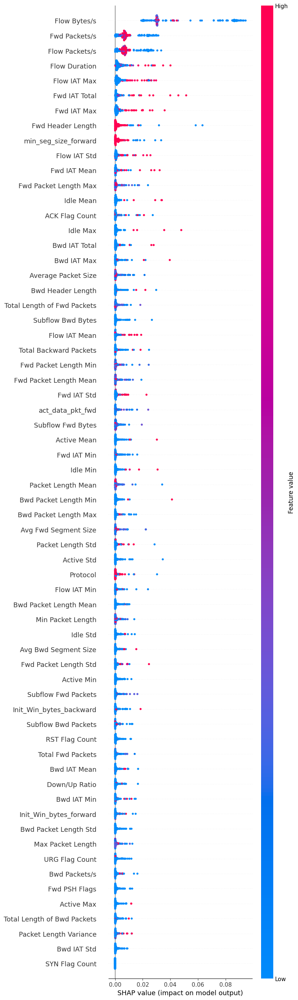

Plotting SHAP values for class 0


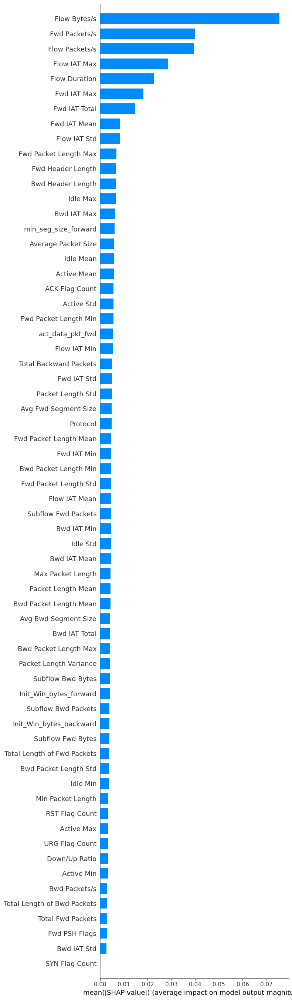

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 1


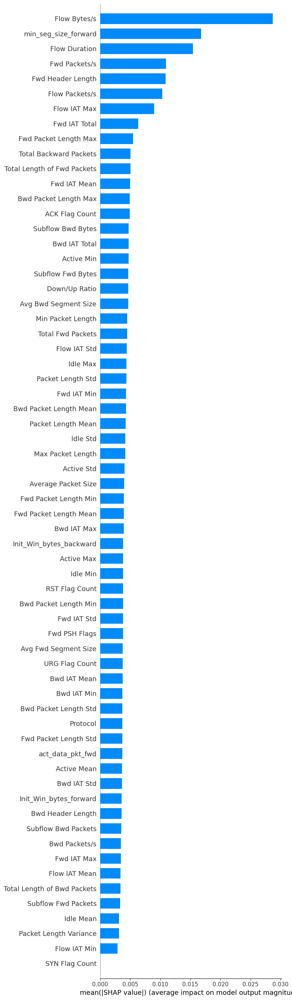

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 2


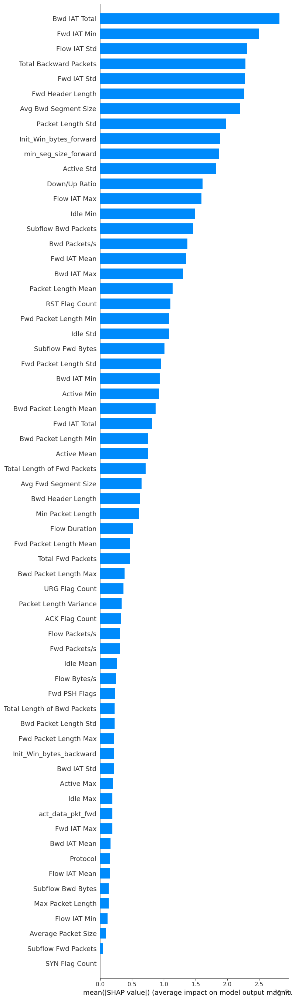

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 3


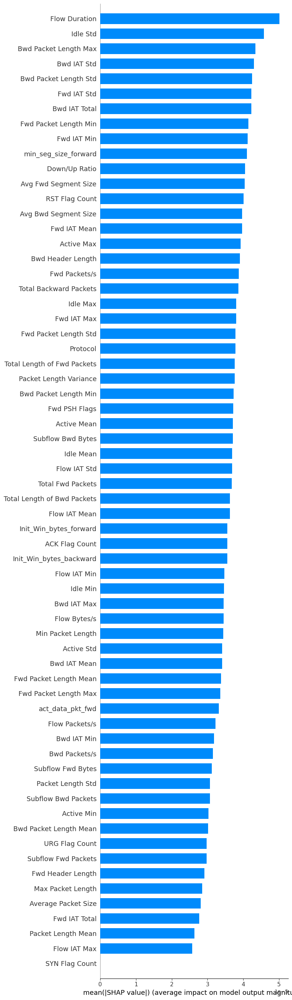

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 4


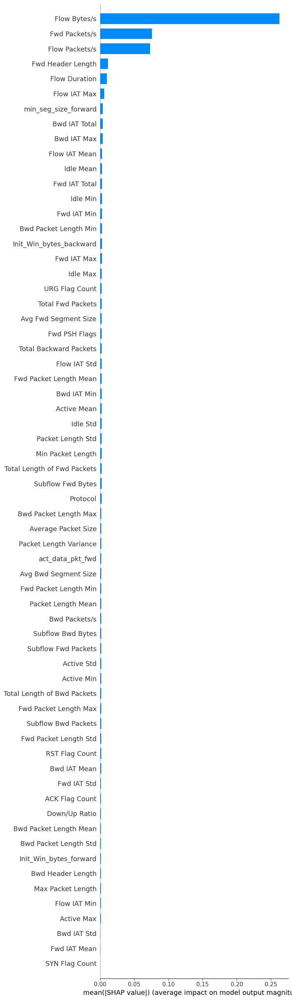

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 5


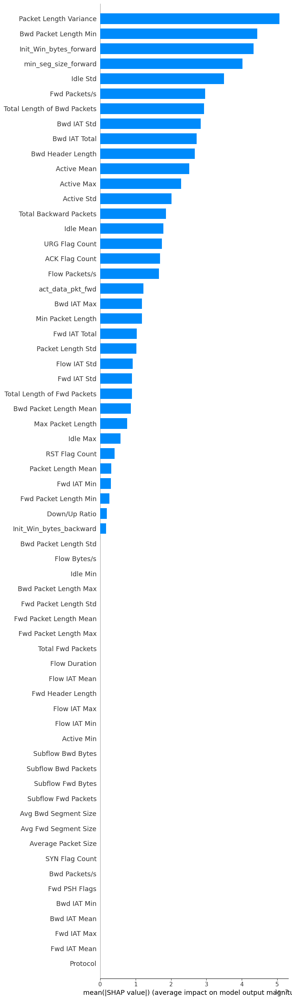

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 6


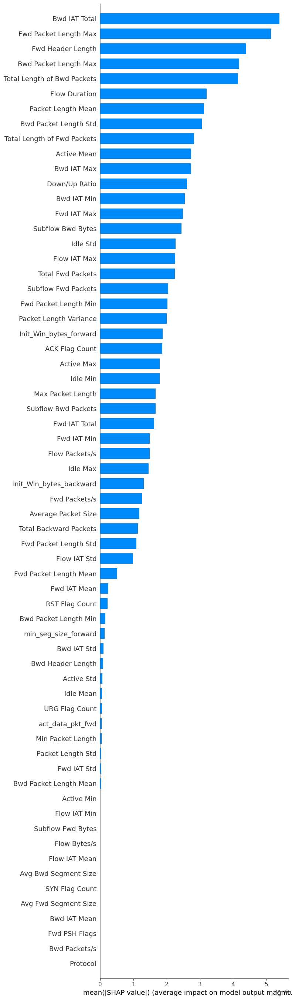

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 7


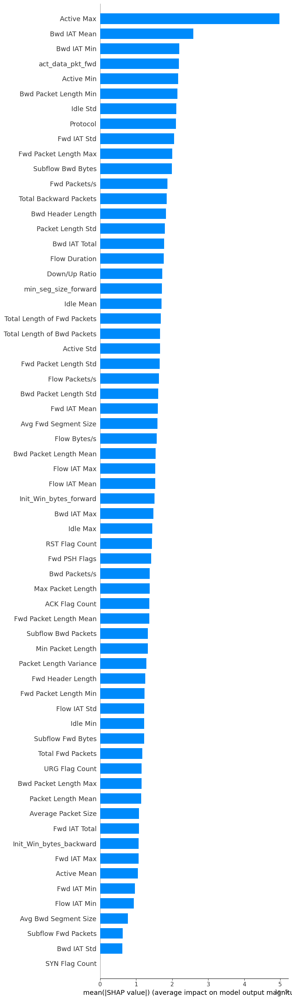

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 8


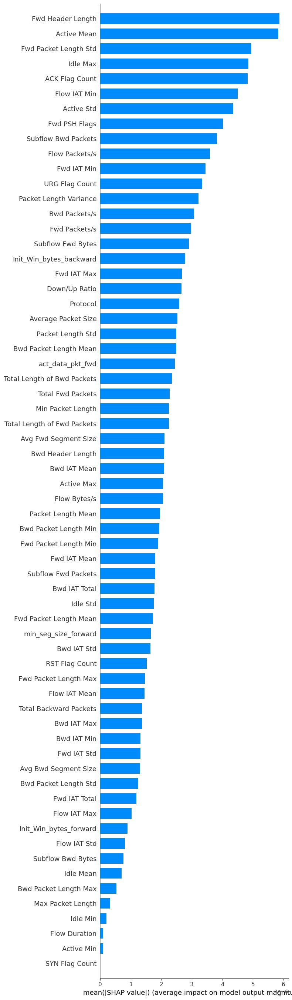

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 9


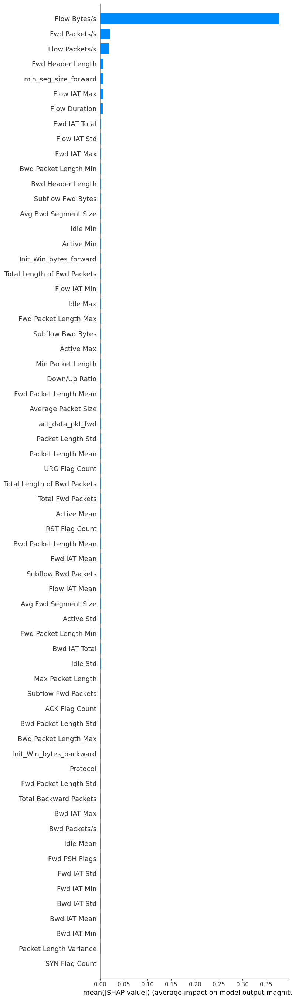

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 10


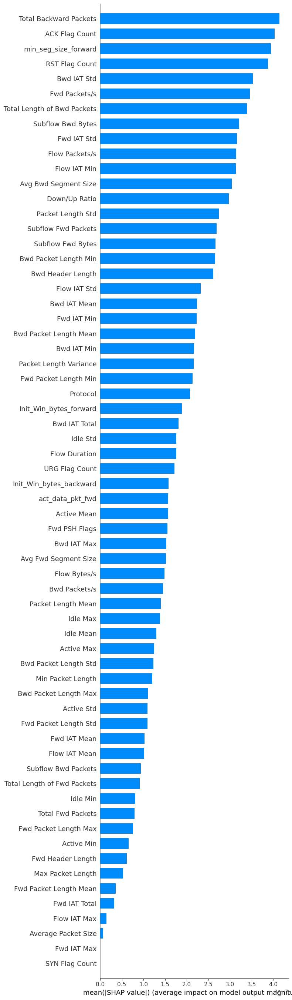

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 11


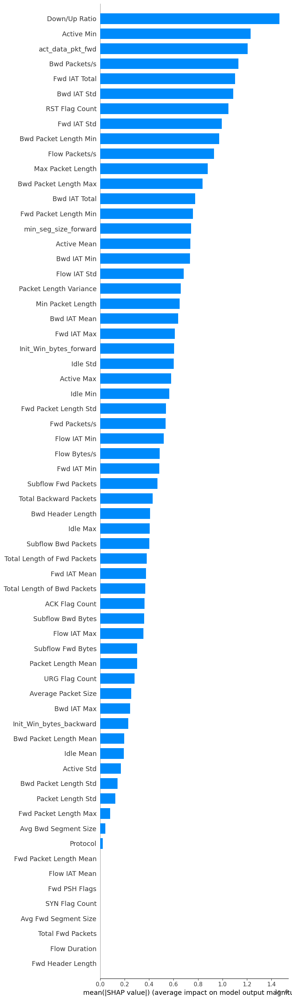

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 12


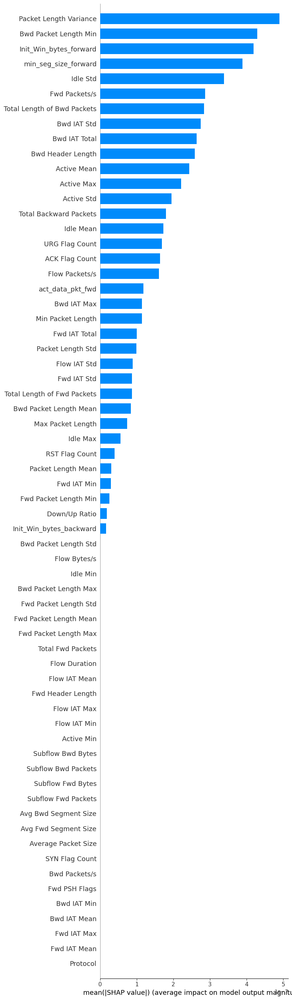

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 13


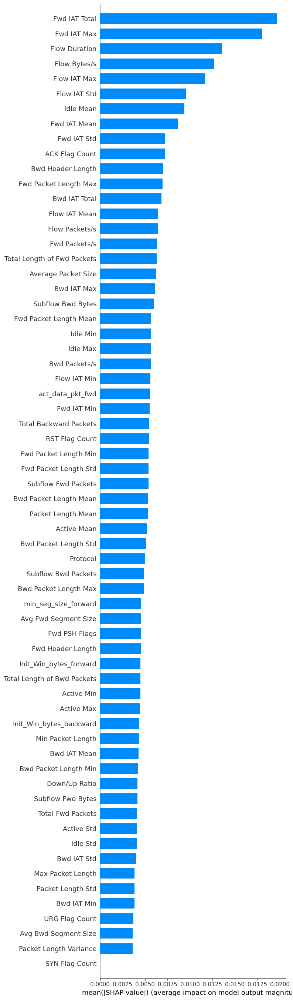

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 14


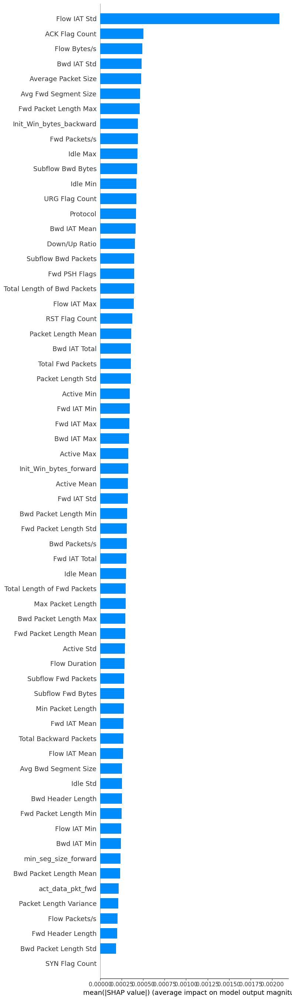

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 15


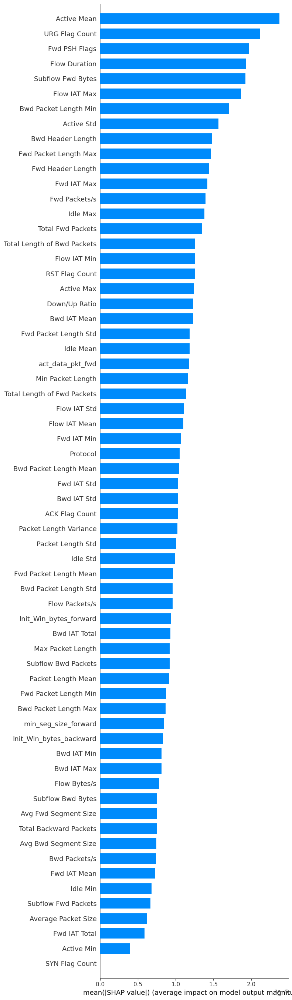

<Figure size 1500x800 with 0 Axes>

Plotting SHAP values for class 16


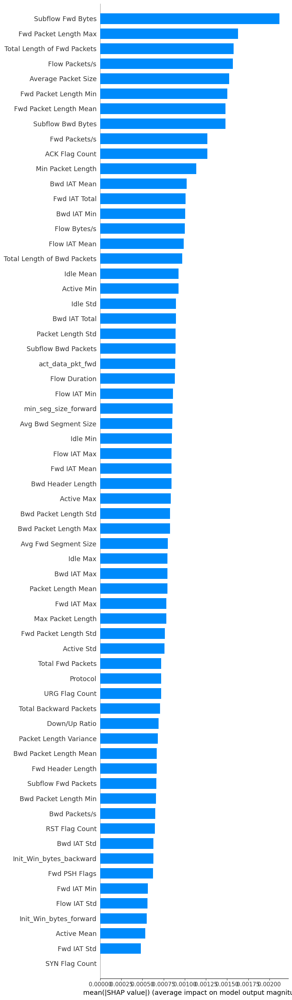

<Figure size 1500x800 with 0 Axes>

In [92]:
#np.savetxt('testV3.1.txt',shap_values)


#shap_values = np.loadtxt('testV3.1.txt')
#print(shap_values.shape)

# Save SHAP values to a file
np.save('test1.npy', shap_values)

# Load SHAP values from the file
shap_values = np.load('test1.npy', allow_pickle=True)

# Inspect the shape of shap_values and data1
print(f"Shape of shap_values: {shap_values.shape}")
print(f"Shape of data1: {data1.shape}")

# Verify the number of features
print(f"Number of features: {len(features)}")

# Calculate the mean absolute SHAP values across all classes
shap_values_mean = np.abs(shap_values).mean(axis=2)

print(f"Shape of shap_values_mean: {shap_values_mean.shape}")

# Plot the mean SHAP values
shap.summary_plot(shap_values_mean, data1, feature_names=features, max_display=75)

# If you want to see SHAP values for each class individually:
for i in range(shap_values.shape[2]):
    print(f"Plotting SHAP values for class {i}")
    plt.figure(figsize=(10, 8))
    shap.summary_plot(
        shap_values[:, :, i], 
        data1, 
        feature_names=features, 
        max_display=75, 
        plot_type="bar", 
        title=f"SHAP values for class {i}"
    )
    plt.tight_layout()
    plt.show()


    

In [93]:
#shap.summary_plot(shap_values, data1, plot_type="bar", class_names= Labels1, feature_names = features)

C:\Users\ecaba\AppData\Local\Temp\ipykernel_4436\91478022.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pos = int(pos[0])


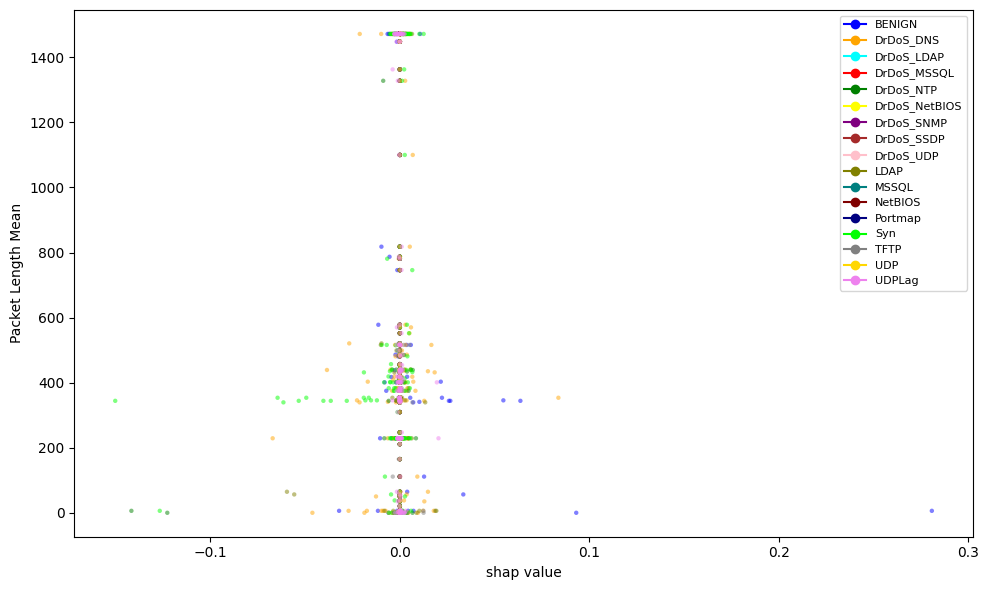

In [94]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

caracteristica = "Packet Length Mean"
pos = np.char.find(features, caracteristica, start=0, end=None)
pos = np.where(pos == 0)
pos = int(pos[0])
plt.rcParams["figure.figsize"] = (10, 6)

# Perform a forward pass to get predictions
model.eval()
with torch.no_grad():
    y_preddata = model(torch.tensor(data1, dtype=torch.float32)).numpy()

labels = ["BENIGN", "DrDoS_DNS", "DrDoS_LDAP", "DrDoS_MSSQL", "DrDoS_NTP", "DrDoS_NetBIOS",
          "DrDoS_SNMP", "DrDoS_SSDP", "DrDoS_UDP", "LDAP", "MSSQL", "NetBIOS", "Portmap",
          "Syn", "TFTP", "UDP", "UDPLag"]

colors = ["blue", "orange", "cyan", "red", "green", "yellow", "purple", "brown", "pink", "olive",
          "teal", "maroon", "navy", "lime", "gray", "gold", "violet"]

custom_lines = [Line2D([0], [0], marker='o', color=c, label=l, markersize=6) for c, l in zip(colors, labels)]

fig, ax = plt.subplots(figsize=(10, 6))

for shap_feature, color, label in zip(shap_values.transpose(2, 0, 1), colors, labels):
    x = shap_feature[:, pos]
    y = data1[:, pos]
    col = [color] * len(y_preddata)
    ax.scatter(x, y, c=col, s=10, linewidth=0, label=label, alpha=0.5)

ax.set_xlabel('shap value')
ax.set_ylabel(caracteristica)
ax.legend(handles=custom_lines, loc="best", prop={'size': 8})

plt.tight_layout()
plt.show()

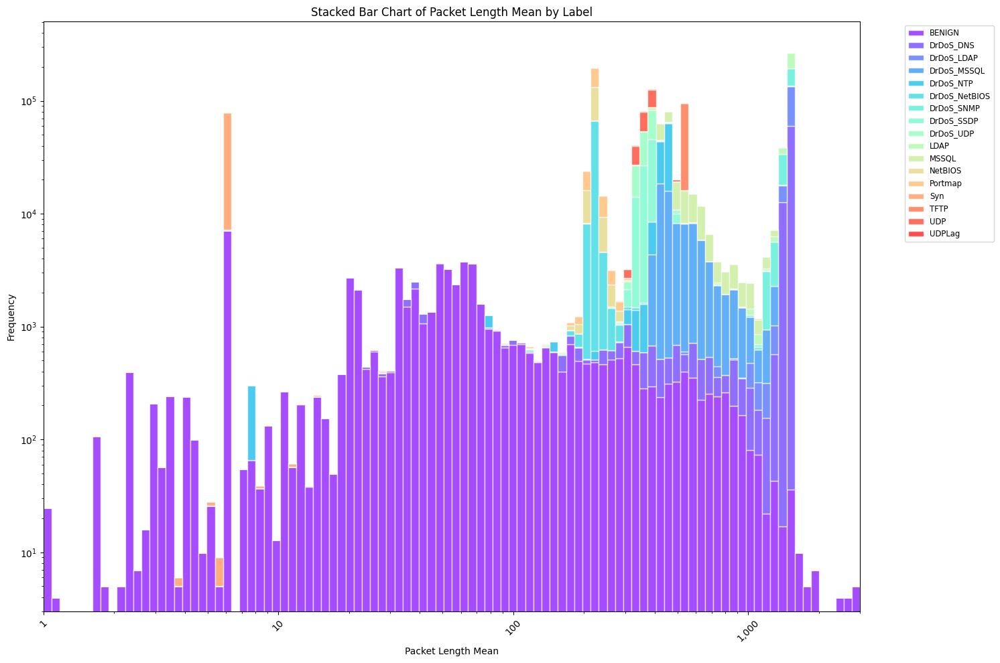

BENIGN: 79775 samples, range: 0.0 - 3657.5288526816
DrDoS_DNS: 79460 samples, range: 0.0 - 1472.0
DrDoS_LDAP: 79834 samples, range: 0.0 - 1472.0
DrDoS_MSSQL: 79697 samples, range: 0.0 - 1472.0
DrDoS_NTP: 79602 samples, range: 0.0 - 1424.0
DrDoS_NetBIOS: 79548 samples, range: 0.0 - 1472.0
DrDoS_SNMP: 79830 samples, range: 0.0 - 1472.0
DrDoS_SSDP: 79755 samples, range: 0.0 - 1472.0
DrDoS_UDP: 79773 samples, range: 0.0 - 1472.0
LDAP: 79828 samples, range: 0.0 - 1472.0
MSSQL: 79498 samples, range: 0.0 - 1472.0
NetBIOS: 79678 samples, range: 6.0 - 589.0
Portmap: 79463 samples, range: 0.0 - 1000.0
Syn: 79734 samples, range: 0.0 - 557.0
TFTP: 79732 samples, range: 0.0 - 1472.0
UDP: 79745 samples, range: 6.0 - 641.0
UDPLag: 79601 samples, range: 0.0 - 1472.0


In [95]:
import matplotlib.pyplot as plt
import numpy as np


# Characteristics and chart settings
caracteris = 'Packet Length Mean'
plt.rcParams["figure.figsize"] = (15, 10)
lim = 3000  # Adjusted to slightly above the max range in the data
bins = 100  # Number of bins for the histogram

# Define labels and colors
labels = ["BENIGN", "DrDoS_DNS", "DrDoS_LDAP", "DrDoS_MSSQL", "DrDoS_NTP", "DrDoS_NetBIOS",
          "DrDoS_SNMP", "DrDoS_SSDP", "DrDoS_UDP", "LDAP", "MSSQL", "NetBIOS", "Portmap",
          "Syn", "TFTP", "UDP", "UDPLag"]

colors = plt.cm.rainbow(np.linspace(0, 1, len(labels)))

# Prepare the figure and axis
fig, ax = plt.subplots()

# Define bin edges (use logarithmic bins)
bin_edges = np.logspace(np.log10(1), np.log10(lim), bins + 1)

# Initialize the bottom of the stacked bars to zero
bottom = np.zeros(bins)

# Plot each label's data as a stacked bar
for label, color in zip(labels, colors):
    data = dataset[dataset['Label'] == label][caracteris]
    data = data[data > 0]  # Exclude non-positive values for log scale
    if not data.empty:
        # Compute histogram for the label
        counts, _ = np.histogram(data, bins=bin_edges)
        # Add stacked bar chart for this label
        ax.bar(bin_edges[:-1], counts, width=np.diff(bin_edges), bottom=bottom, 
               color=color, alpha=0.7, edgecolor='white', label=label, align='edge')
        # Update the bottom for stacking
        bottom += counts

# Set axis labels and title
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlim([1, lim])
ax.set_xlabel(caracteris)
ax.set_ylabel('Frequency')
ax.set_title(f'Stacked Bar Chart of {caracteris} by Label')

# Format x-axis ticks to show readable numbers
ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Add a legend outside the plot for clarity
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')

# Adjust layout for better fit
plt.tight_layout()

# Show the plot
plt.show()

# Print information about the data for each label
for label in labels:
    data = dataset[dataset['Label'] == label][caracteris]
    print(f"{label}: {len(data)} samples, range: {data.min()} - {data.max()}")

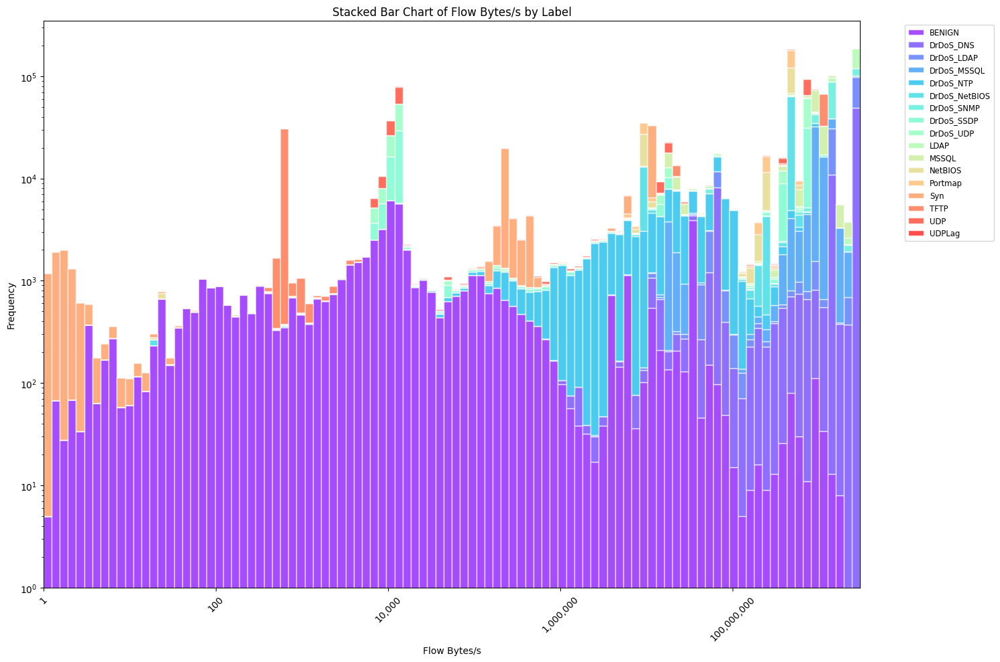

BENIGN: 79775 samples, range: -1.0 - 1947000000.0
DrDoS_DNS: 79460 samples, range: -1.0 - 2944000000.0
DrDoS_LDAP: 79834 samples, range: -1.0 - 2944000000.0
DrDoS_MSSQL: 79697 samples, range: -1.0 - 2944000000.0
DrDoS_NTP: 79602 samples, range: -1.0 - 1760000000.0
DrDoS_NetBIOS: 79548 samples, range: -1.0 - 2596000000.0
DrDoS_SNMP: 79830 samples, range: -1.0 - 2944000000.0
DrDoS_SSDP: 79755 samples, range: -1.0 - 2944000000.0
DrDoS_UDP: 79773 samples, range: -1.0 - 2944000000.0
LDAP: 79828 samples, range: -1.0 - 2944000000.0
MSSQL: 79498 samples, range: -1.0 - 2944000000.0
NetBIOS: 79678 samples, range: -1.0 - 1178000000.0
Portmap: 79463 samples, range: -1.0 - 2000000000.0
Syn: 79734 samples, range: -1.0 - 730000000.0
TFTP: 79732 samples, range: -1.0 - 1472000000.0
UDP: 79745 samples, range: -1.0 - 1318000000.0
UDPLag: 79601 samples, range: -1.0 - 2944000000.0


In [96]:
import matplotlib.pyplot as plt
import numpy as np

# Characteristics and chart settings
caracteris = 'Flow Bytes/s'
plt.rcParams["figure.figsize"] = (15, 10)
lim = 3000000000  # Adjusted to slightly above the max range in the data
bins = 100  # Number of bins for the histogram

# Define labels and colors
labels = ["BENIGN", "DrDoS_DNS", "DrDoS_LDAP", "DrDoS_MSSQL", "DrDoS_NTP", "DrDoS_NetBIOS",
          "DrDoS_SNMP", "DrDoS_SSDP", "DrDoS_UDP", "LDAP", "MSSQL", "NetBIOS", "Portmap",
          "Syn", "TFTP", "UDP", "UDPLag"]

colors = plt.cm.rainbow(np.linspace(0, 1, len(labels)))

# Prepare the figure and axis
fig, ax = plt.subplots()

# Define bin edges (use logarithmic bins)
bin_edges = np.logspace(np.log10(1), np.log10(lim), bins + 1)

# Initialize the bottom of the stacked bars to zero
bottom = np.zeros(bins)

# Plot each label's data as a stacked bar
for label, color in zip(labels, colors):
    data = dataset[dataset['Label'] == label][caracteris]
    data = data[data > 0]  # Exclude non-positive values for log scale
    if not data.empty:
        # Compute histogram for the label
        counts, _ = np.histogram(data, bins=bin_edges)
        # Add stacked bar chart for this label
        ax.bar(bin_edges[:-1], counts, width=np.diff(bin_edges), bottom=bottom, 
               color=color, alpha=0.7, edgecolor='white', label=label, align='edge')
        # Update the bottom for stacking
        bottom += counts

# Set axis labels and title
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlim([1, lim])
ax.set_xlabel(caracteris)
ax.set_ylabel('Frequency')
ax.set_title(f'Stacked Bar Chart of {caracteris} by Label')

# Format x-axis ticks to show readable numbers
ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Add a legend outside the plot for clarity
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')

# Adjust layout for better fit
plt.tight_layout()

# Show the plot
plt.show()

# Print information about the data for each label
for label in labels:
    data = dataset[dataset['Label'] == label][caracteris]
    print(f"{label}: {len(data)} samples, range: {data.min()} - {data.max()}")

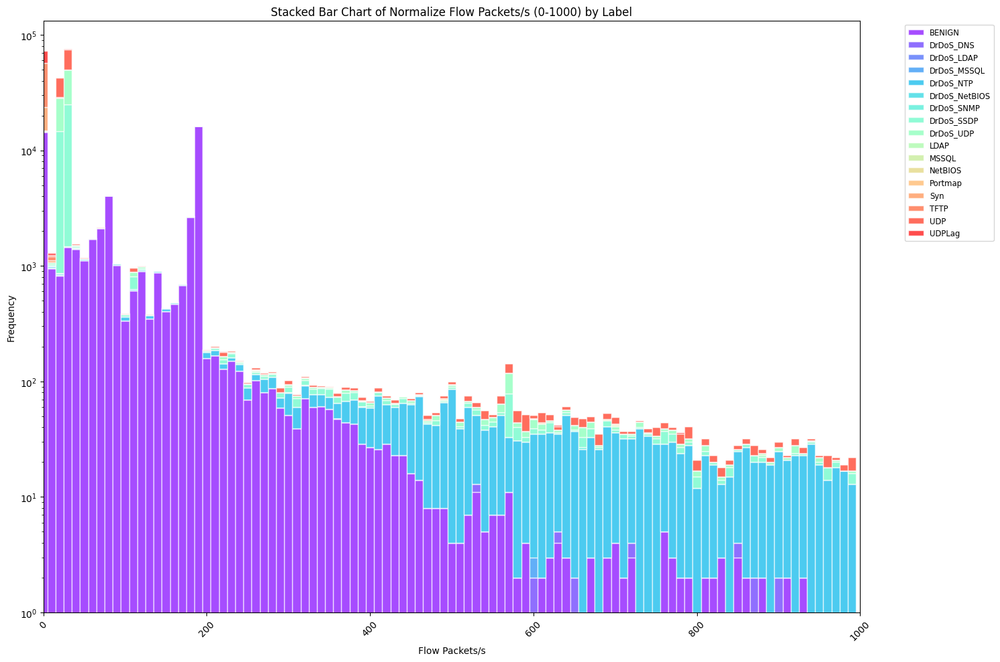

BENIGN: 54476 samples in 0-1000 range, full range: -1.0 - 3000000.0
DrDoS_DNS: 23 samples in 0-1000 range, full range: -1.0 - 2000000.0
DrDoS_LDAP: 5 samples in 0-1000 range, full range: -1.0 - 2000000.0
DrDoS_MSSQL: 90 samples in 0-1000 range, full range: -1.0 - 2000000.0
DrDoS_NTP: 2603 samples in 0-1000 range, full range: -1.0 - 4000000.0
DrDoS_NetBIOS: 47 samples in 0-1000 range, full range: -1.0 - 2000000.0
DrDoS_SNMP: 37 samples in 0-1000 range, full range: -1.0 - 2000000.0
DrDoS_SSDP: 38073 samples in 0-1000 range, full range: -1.0 - 3000000.0
DrDoS_UDP: 39339 samples in 0-1000 range, full range: -1.0 - 2000000.0
LDAP: 7 samples in 0-1000 range, full range: -1.0 - 2000000.0
MSSQL: 58 samples in 0-1000 range, full range: -1.0 - 2000000.0
NetBIOS: 113 samples in 0-1000 range, full range: -1.0 - 2000000.0
Portmap: 34 samples in 0-1000 range, full range: -1.0 - 2000000.0
Syn: 8934 samples in 0-1000 range, full range: -1.0 - 2000000.0
TFTP: 33506 samples in 0-1000 range, full range: 

In [97]:
import matplotlib.pyplot as plt
import numpy as np

# Characteristics and chart settings
caracteris = 'Flow Packets/s'
plt.rcParams["figure.figsize"] = (15, 10)
lim = 1000  # Set limit to 1000 as requested
bins = 100  # Increased number of bins for finer granularity

# Define labels and colors
labels = ["BENIGN", "DrDoS_DNS", "DrDoS_LDAP", "DrDoS_MSSQL", "DrDoS_NTP", "DrDoS_NetBIOS",
          "DrDoS_SNMP", "DrDoS_SSDP", "DrDoS_UDP", "LDAP", "MSSQL", "NetBIOS", "Portmap",
          "Syn", "TFTP", "UDP", "UDPLag"]

colors = plt.cm.rainbow(np.linspace(0, 1, len(labels)))

# Prepare the figure and axis
fig, ax = plt.subplots()

# Define bin edges
bin_edges = np.linspace(0, lim, bins + 1)

# Initialize the bottom of the stacked bars to zero
bottom = np.zeros(bins)

# Plot each label's data as a stacked bar
for label, color in zip(labels, colors):
    data = dataset[dataset['Label'] == label][caracteris]
    data = data[(data >= 0) & (data <= lim)]  # Filter data within the 0-1000 range
    if not data.empty:
        # Compute histogram for the label
        counts, _ = np.histogram(data, bins=bin_edges)
        # Add stacked bar chart for this label
        ax.bar(bin_edges[:-1], counts, width=np.diff(bin_edges)[0], bottom=bottom, 
               color=color, alpha=0.7, edgecolor='white', label=label)
        # Update the bottom for stacking
        bottom += counts

# Set axis labels and title
ax.set_xlim([0, lim])
ax.set_xlabel(caracteris)
ax.set_ylabel('Frequency')
ax.set_title(f'Stacked Bar Chart of Normalize {caracteris} (0-1000) by Label')

# Use logarithmic scale for y-axis to better visualize differences
ax.set_yscale('log')

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Add a legend outside the plot for clarity
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')

# Adjust layout for better fit
plt.tight_layout()

# Show the plot
plt.show()

# Print information about the data for each label within the 0-1000 range
for label in labels:
    data = dataset[dataset['Label'] == label][caracteris]
    filtered_data = data[(data >= 0) & (data <= lim)]
    print(f"{label}: {len(filtered_data)} samples in 0-1000 range, full range: {data.min()} - {data.max()}")

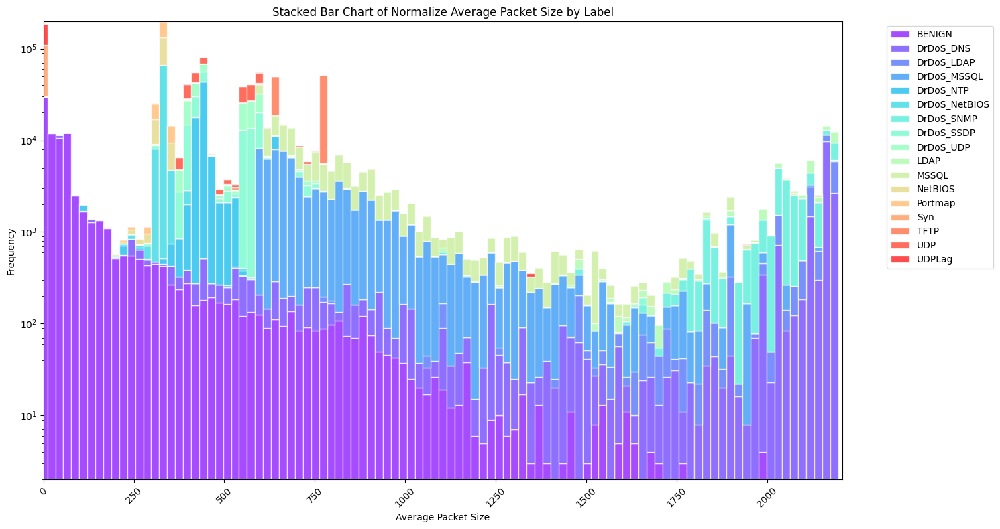

BENIGN: 79775 samples, range: 0.0 - 3660.0135869565215
DrDoS_DNS: 79460 samples, range: 0.0 - 2208.0
DrDoS_LDAP: 79834 samples, range: 0.0 - 2208.0
DrDoS_MSSQL: 79697 samples, range: 0.0 - 2208.0
DrDoS_NTP: 79602 samples, range: 0.0 - 2136.0
DrDoS_NetBIOS: 79548 samples, range: 0.0 - 2208.0
DrDoS_SNMP: 79830 samples, range: 0.0 - 2208.0
DrDoS_SSDP: 79755 samples, range: 0.0 - 2208.0
DrDoS_UDP: 79773 samples, range: 0.0 - 2208.0
LDAP: 79828 samples, range: 0.0 - 2208.0
MSSQL: 79498 samples, range: 0.0 - 2208.0
NetBIOS: 79678 samples, range: 7.0 - 883.5
Portmap: 79463 samples, range: 0.0 - 1500.0
Syn: 79734 samples, range: 0.0 - 835.5
TFTP: 79732 samples, range: 0.0 - 2208.0
UDP: 79745 samples, range: 7.0 - 961.5
UDPLag: 79601 samples, range: 0.0 - 2208.0


In [98]:
import matplotlib.pyplot as plt
import numpy as np

# Characteristics and chart settings
caracteris = 'Average Packet Size'
plt.rcParams["figure.figsize"] = (15, 8)
lim = 2208  # Data limit for visualization
bins = 100  # Increased number of bins for finer granularity

# Define labels and colors
labels = ["BENIGN", "DrDoS_DNS", "DrDoS_LDAP", "DrDoS_MSSQL", "DrDoS_NTP", "DrDoS_NetBIOS",
          "DrDoS_SNMP", "DrDoS_SSDP", "DrDoS_UDP", "LDAP", "MSSQL", "NetBIOS", "Portmap",
          "Syn", "TFTP", "UDP", "UDPLag"]

colors = plt.cm.rainbow(np.linspace(0, 1, len(labels)))

# Prepare the figure and axis
fig, ax = plt.subplots()

# Define bin edges
bin_edges = np.linspace(0, lim, bins + 1)

# Initialize the bottom of the stacked bars to zero
bottom = np.zeros(bins)

# Plot each label's data as a stacked bar
for label, color in zip(labels, colors):
    data = dataset[dataset['Label'] == label][caracteris]
    data = data[data < lim]  # Apply limit to data
    if not data.empty:
        # Compute histogram for the label
        counts, _ = np.histogram(data, bins=bin_edges)
        # Add stacked bar chart for this label with uniform width
        ax.bar(bin_edges[:-1], counts, width=np.diff(bin_edges)[0], bottom=bottom, color=color, alpha=0.7, edgecolor='white', label=label)
        # Update the bottom for stacking
        bottom += counts

# Set axis labels and title
ax.set_xlim([0, lim])
ax.set_xlabel(caracteris)
ax.set_ylabel('Frequency')
ax.set_title(f'Stacked Bar Chart of Normalize {caracteris} by Label')

# Use logarithmic scale for better visibility of small differences
ax.set_yscale('log')

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Add a legend outside the plot for clarity
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout for better fit
plt.tight_layout()

# Show the plot
plt.show()

# Print information about the data for each label
for label in labels:
    data = dataset[dataset['Label'] == label][caracteris]
    print(f"{label}: {len(data)} samples, range: {data.min()} - {data.max()}")



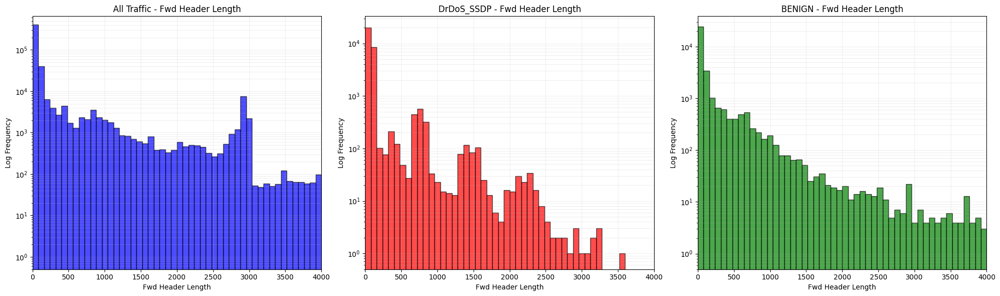

Total samples: 578806
DrDoS_SSDP samples: 34046
BENIGN samples: 33953

Types of traffic in the dataset:
Label
Portmap          34365
DrDoS_DNS        34362
MSSQL            34330
DrDoS_NetBIOS    34280
UDPLag           34227
NetBIOS          34150
DrDoS_MSSQL      34131
TFTP             34096
Syn              34094
UDP              34081
DrDoS_SSDP       34046
DrDoS_UDP        34034
DrDoS_SNMP       33997
LDAP             33992
DrDoS_LDAP       33990
BENIGN           33953
DrDoS_NTP        32678
Name: count, dtype: int64


In [99]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

caracteris = 'Fwd Header Length'
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 6))
lim = 4000

pruebadf = dataset1[dataset1[caracteris] < lim]
DrDoS_SSDP_df = pruebadf[pruebadf['Label'] == 'DrDoS_SSDP']
Benigndf = pruebadf[pruebadf['Label'] == "BENIGN"]

bin = 50

# Función para crear histograma
def plot_histogram(ax, data, title, color):
    counts, bins, _ = ax.hist(data, bins=bin, range=(0, lim), color=color, edgecolor='black', alpha=0.7)
    ax.set_title(title)
    ax.set_xlim([0, lim])
    ax.set_xlabel(caracteris)
    ax.set_ylabel('Log Frequency')
    ax.set_yscale('log')
    ax.grid(True, which="both", ls="-", alpha=0.2)
    # Añadir valor 1 a las barras vacías para que aparezcan en la escala logarítmica
    counts[counts == 0] = 1
    ax.set_ylim(bottom=0.5)  # Ajustar el límite inferior para mostrar las barras con valor 1

# Histograma para todo el tráfico
plot_histogram(ax[0], pruebadf[caracteris], f'All Traffic - {caracteris}', 'blue')

# Histograma para DrDoS_SSDP (aunque esté vacío)
plot_histogram(ax[1], DrDoS_SSDP_df[caracteris], f'DrDoS_SSDP - {caracteris}', 'red')

# Histograma para tráfico BENIGN
plot_histogram(ax[2], Benigndf[caracteris], f'BENIGN - {caracteris}', 'green')

plt.tight_layout()
plt.show()

# Imprimir estadísticas
print(f"Total samples: {len(pruebadf)}")
print(f"DrDoS_SSDP samples: {len(DrDoS_SSDP_df)}")
print(f"BENIGN samples: {len(Benigndf)}")

# Mostrar tipos de tráfico presentes
print("\nTypes of traffic in the dataset:")
traffic_types = pruebadf['Label'].value_counts()
print(traffic_types)

In [100]:
#print(shap_values.shape)
#print(explainer.expected_value)
#print(len(features))
#print(len(Labels))

import numpy as np

shap.initjs()

# Selecciona una clase específica para visualizar (por ejemplo, la primera clase)
class_index = 0

# Extrae los valores SHAP para la clase seleccionada
shap_values_class = shap_values[:, :, class_index]

# Asegúrate de que data1 sea un array de numpy si no lo es ya
data1_np = np.array(data1)

# Crea el force plot
shap.plots.force(
    base_value=explainer.expected_value[class_index],
    shap_values=shap_values_class,
    features=data1_np,
    feature_names=features,
    out_names=Labels[class_index]  # Usa solo el nombre de la clase seleccionada
)


In [101]:
model.eval()
with torch.no_grad():
    y_preddata = model(torch.tensor(data1, dtype=torch.float32)).numpy()


In [102]:
num=25;
# Selecciona una clase específica para visualizar (por ejemplo, la primera clase)
class_index = 0

# Extrae los valores SHAP para la clase seleccionada
shap_values_class = shap_values[:, :, class_index]

# Asegúrate de que data1 sea un array de numpy si no lo es ya
data1_np = np.array(data1)

# Crea el force plot
shap.plots.force(
    base_value=explainer.expected_value[class_index],
    shap_values=shap_values_class[num,:],
    features=data1_np[num,:],
    feature_names=features,
    out_names=Labels[class_index]  # Usa solo el nombre de la clase seleccionada
)

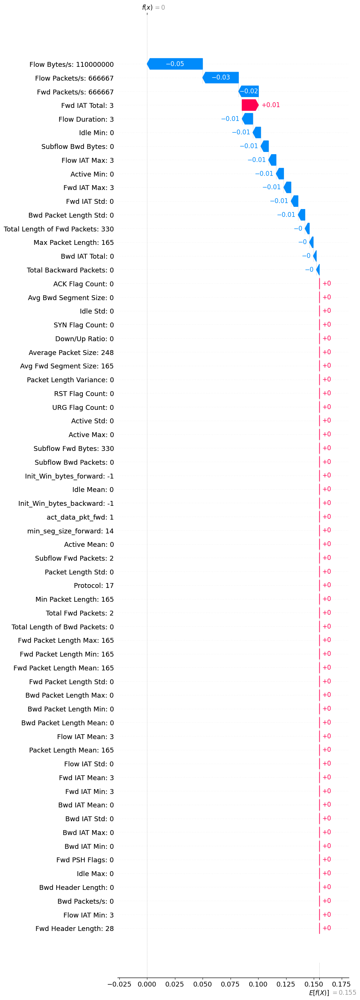

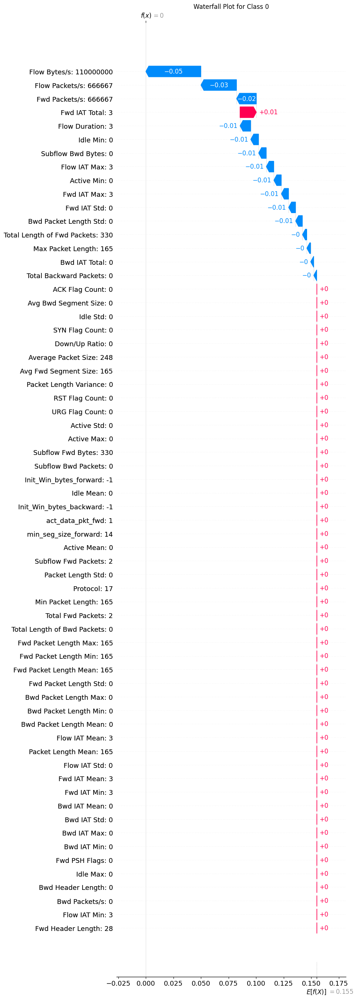

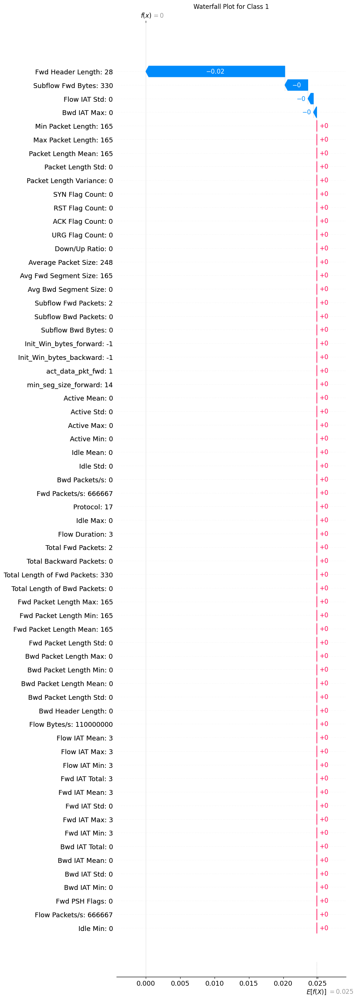

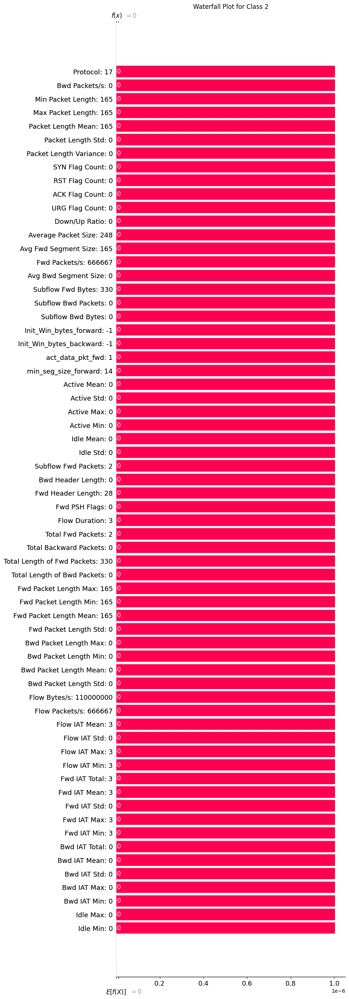

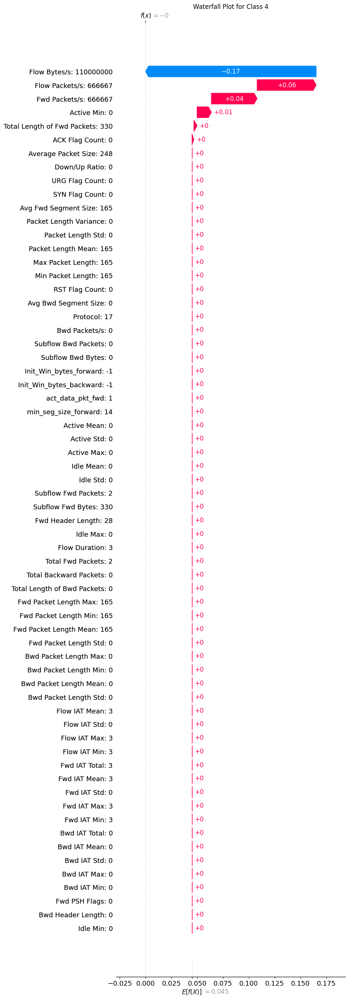

KeyboardInterrupt: 

In [103]:
# Selecciona una clase específica para visualizar (por ejemplo, la primera clase)
class_index = 0

# Crea la lista de características con sus valores
feature = [f"{a}: {int(b)}" for a, b in zip(features, data1[num].round(0))]

# Usa el expected_value correspondiente a la clase seleccionada
expected_value_class = explainer.expected_value[class_index]

# Selecciona los valores SHAP para la muestra 'num' y la clase seleccionada
shap_values_class = shap_values[num, :, class_index]

# Crea el gráfico de cascada
shap.plots._waterfall.waterfall_legacy(
    expected_value_class,
    shap_values_class,
    feature_names=feature,
    max_display=80
)

for class_index in range(shap_values.shape[2]):
    plt.figure(figsize=(12, 8))
    plt.title(f"Waterfall Plot for Class {class_index}")
    expected_value_class = explainer.expected_value[class_index]
    shap_values_class = shap_values[num, :, class_index]
    
    shap.plots._waterfall.waterfall_legacy(
        expected_value_class,
        shap_values_class,
        feature_names=feature,
        max_display=80
    )
    
    #plt.tight_layout()
    #plt.show()

In [ ]:
#REVISAR
nuevo_shap = np.zeros_like(shap_values[0])
nuevo_data = np.zeros_like(data1[0])
nuevo_min = data1[0].copy()
nuevo_max = np.zeros_like(data1[0])
nuevo_std = np.zeros_like(data1[0])
acum = 0
ata = 2
margen = 0.2

for i in range(size):
    suma = np.sum(shap_values[i]) + np.sum(explainer.expected_value)
    if (ata - abs(margen)) < suma < (ata + abs(margen)):
        nuevo_shap += shap_values[i]
        nuevo_data += data1[i]
        nuevo_min = np.minimum(nuevo_min, data1[i])
        nuevo_max = np.maximum(nuevo_max, data1[i])
        acum += 1

if acum > 0:
    nuevo_shap /= acum
    nuevo_data /= acum

    # Cálculo del STD
    nuevo_std = np.zeros_like(data1[0])
    for i in range(size):
        suma = np.sum(shap_values[i]) + np.sum(explainer.expected_value)
        if (ata - abs(margen)) < suma < (ata + abs(margen)):
            nuevo_std += (data1[i] - nuevo_data) ** 2
    
    nuevo_std = np.sqrt(nuevo_std / acum)

    feature = [f"{a}\n {int(b)} {int(c)} {int(d)} {int(e)}"
               for a, b, c, d, e in zip(features, nuevo_min, nuevo_data, nuevo_std, nuevo_max)]

    print(Labels[ata])
    shap.plots._waterfall.waterfall_legacy(np.sum(explainer.expected_value), nuevo_shap, feature_names=feature, max_display=11)
else:
    print(f"No se encontraron muestras para la clase {Labels[ata]} dentro del margen especificado.")
    print(f"Valor objetivo: {ata}")
    print(f"Margen: {margen}")
    print(f"Rango de suma aceptado: {ata - abs(margen)} a {ata + abs(margen)}")

No se encontraron muestras para la clase DrDoS_SNMP dentro del margen especificado.
Valor objetivo: 2
Margen: 0.2
Rango de suma aceptado: 1.8 a 2.2


#### DECISION TREE

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import LabelEncoder
import numpy as np

# Supongamos que X_train, X_test, Y_train, Y_test ya están definidos
X_trainArr = X_train.to_numpy() if not isinstance(X_train, np.ndarray) else X_train
X_testArr = X_test.to_numpy() if not isinstance(X_test, np.ndarray) else X_test

# Convertir etiquetas de texto a enteros
label_encoder = LabelEncoder()
Y_trainArr = label_encoder.fit_transform(Y_train)

LabelsArr = label_encoder.classes_

# Ajustar Y_trainArr si es necesario para que coincida con X_trainArr
Y_trainArr = Y_trainArr[:len(X_trainArr)]
assert len(X_trainArr) == len(Y_trainArr), "X_trainArr y Y_trainArr deben tener el mismo número de muestras."

# Entrenamiento del modelo con RandomForestClassifier optimizado
clf = RandomForestClassifier(
    random_state=0,
    n_estimators=200,  # Aumenta el número de árboles
    max_depth=None,  # Permitir una mayor profundidad
    min_samples_split=2,  # Permitir divisiones más pequeñas
    min_samples_leaf=1,  # Permitir hojas más pequeñas
    class_weight='balanced_subsample'  # Balancear las clases usando el subconjunto
)
clf.fit(X_trainArr, Y_trainArr)

# Validación cruzada
cv_scores = cross_val_score(clf, X_trainArr, Y_trainArr, cv=5)
print(f"Cross-validation scores: {cv_scores}")

# Predicción sobre los datos de prueba
y_testree1 = Y_test  # Etiquetas reales del conjunto de prueba
y_predtree1 = clf.predict(X_testArr)  # Predicción usando el modelo entrenado

# Generar y mostrar el reporte de clasificación
print(classification_report(y_testree1, y_predtree1, digits=8, zero_division="warn"))

# Mostrar la precisión del modelo
accuracy_modelo = accuracy_score(y_testree1, y_predtree1)
print(f"Precisión del modelo: {accuracy_modelo}")


KeyboardInterrupt: 

C:\Users\ecaba\AppData\Local\Temp\ipykernel_9532\3019520567.py:22: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', len(labels))


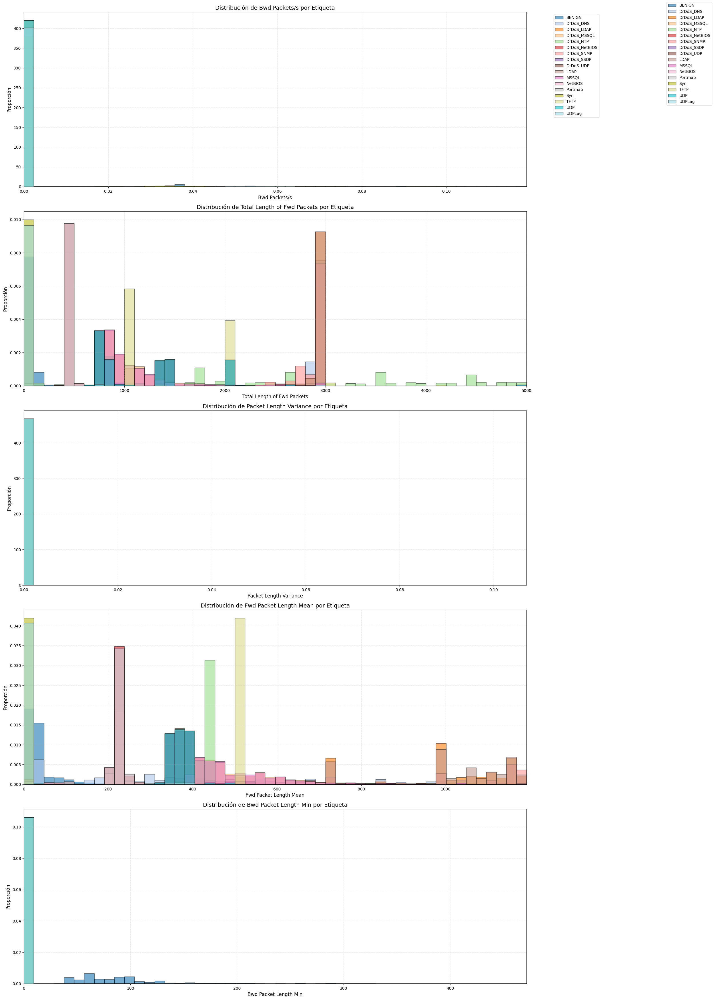


Información sobre los datos:

Característica: Bwd Packets/s
BENIGN: 19754 muestras, rango: 0.0000 - 0.1190
DrDoS_DNS: 79452 muestras, rango: 0.0000 - 0.0000
DrDoS_LDAP: 79819 muestras, rango: 0.0000 - 0.0000
DrDoS_MSSQL: 79690 muestras, rango: 0.0000 - 0.0000
DrDoS_NTP: 79554 muestras, rango: 0.0000 - 0.0000
DrDoS_NetBIOS: 79535 muestras, rango: 0.0000 - 0.0000
DrDoS_SNMP: 79816 muestras, rango: 0.0000 - 0.0000
DrDoS_SSDP: 79739 muestras, rango: 0.0000 - 0.0000
DrDoS_UDP: 79765 muestras, rango: 0.0000 - 0.0000
LDAP: 79820 muestras, rango: 0.0000 - 0.0000
MSSQL: 79493 muestras, rango: 0.0000 - 0.0000
NetBIOS: 79674 muestras, rango: 0.0000 - 0.0000
Portmap: 79413 muestras, rango: 0.0000 - 0.0000
Syn: 53746 muestras, rango: 0.0000 - 0.1189
TFTP: 79724 muestras, rango: 0.0000 - 0.0000
UDP: 79743 muestras, rango: 0.0000 - 0.0000
UDPLag: 72478 muestras, rango: 0.0000 - 0.1189

Característica: Total Length of Fwd Packets
BENIGN: 77199 muestras, rango: 0.0000 - 5000.0000
DrDoS_DNS: 79406 mues

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Asumimos que 'dataset' es tu DataFrame con los datos
# Si no está definido, necesitarás cargar tus datos primero

# Definir las 5 características más destacables y sus límites
top_features = [
    'Bwd Packets/s',
    'Total Length of Fwd Packets',
    'Packet Length Variance',
    'Fwd Packet Length Mean',
    'Bwd Packet Length Min'
]
limits = [0.119, 5000.0, 0.107, 1191.5, 471.5]

# Definir los labels y colores
labels = ["BENIGN", "DrDoS_DNS", "DrDoS_LDAP", "DrDoS_MSSQL", "DrDoS_NTP", "DrDoS_NetBIOS",
          "DrDoS_SNMP", "DrDoS_SSDP", "DrDoS_UDP", "LDAP", "MSSQL", "NetBIOS", "Portmap",
          "Syn", "TFTP", "UDP", "UDPLag"]
colors = plt.cm.get_cmap('tab20', len(labels))

# Crear la figura
plt.figure(figsize=(25, 35))

# Dibujar los histogramas normalizados para cada característica
for i, (feature, limit) in enumerate(zip(top_features, limits), 1):
    plt.subplot(5, 1, i)
    
    for label in labels:
        data = dataset[dataset['Label'] == label][feature]
        data = data[data <= limit]  # Aplicar el límite
        if not data.empty:
            plt.hist(data, bins=50, range=(0, limit), density=True, alpha=0.6, 
                     label=label, color=colors(labels.index(label)), edgecolor='black')
    
    plt.xlabel(feature, fontsize=12)
    plt.ylabel('Proporción', fontsize=12)
    plt.title(f'Distribución de {feature} por Etiqueta', fontsize=14)
    plt.xlim(0, limit)
    plt.grid(True, alpha=0.3, linestyle='--')
    
    if i == 1:  # Solo añadir leyenda al primer subgráfico
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)

# Ajustar el diseño para que la leyenda no corte
plt.tight_layout(rect=[0, 0, 0.85, 1])

# Añadir una leyenda central
handles, _ = plt.gca().get_legend_handles_labels()
fig = plt.gcf()
fig.legend(handles, labels, loc='upper right', fontsize=10)

# Mostrar el gráfico
plt.show()

# Imprimir información sobre los datos
print("\nInformación sobre los datos:")
for feature, limit in zip(top_features, limits):
    print(f"\nCaracterística: {feature}")
    for label in labels:
        data = dataset[dataset['Label'] == label][feature]
        data = data[data <= limit]
        if not data.empty:
            print(f"{label}: {len(data)} muestras, rango: {data.min():.4f} - {data.max():.4f}")
        else:
            print(f"{label}: 0 muestras")